# Analyse dataset Peyser (GSE129605)

In [73]:
import scanpy as sc
import os
import gzip
import shutil
from tqdm.notebook import tqdm
import anndata
import matplotlib.pyplot as plt
import helpers_danielstrobel
from IPython.display import Image
import numpy as np
import seaborn as sns
from scipy.stats import median_abs_deviation
import anndata2ri
import logging
import scrublet
import pandas as pd


import rpy2.rinterface_lib.callbacks as rcb
import rpy2.robjects as ro


rcb.logger.setLevel(logging.ERROR)
ro.pandas2ri.activate()
anndata2ri.activate()

%load_ext rpy2.ipython

sc.settings.verbosity = 0
sc.settings.set_figure_params(
    dpi=80,
    facecolor="white",
    frameon=False,
)
plt.rcParams['figure.figsize'] = (9, 9)

The rpy2.ipython extension is already loaded. To reload it, use:
  %reload_ext rpy2.ipython


/Users/leahollenberg/Desktop/Masterpraktikum/PycharmProjects/scanpy_start/venv/lib/python3.8/site-packages/rpy2/robjects/pandas2ri.py:368: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  warnings.warn('The global conversion available with activate() '
/Users/leahollenberg/Desktop/Masterpraktikum/PycharmProjects/scanpy_start/venv/lib/python3.8/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)


## Load Datasets processed by Daniel

In [62]:
adata_preprocessed = sc.read("data/preprocessed.h5ad")
adata_twc = sc.read("data/together_wo_clusters.h5ad")

/Users/leahollenberg/Desktop/Masterpraktikum/PycharmProjects/scanpy_start/venv/lib/python3.8/site-packages/anndata/_io/specs/registry.py:235: OldFormatWarning: Element '/layers' was written without encoding metadata.
  return self.callback(read_func, elem.name, elem, iospec=get_spec(elem))
/Users/leahollenberg/Desktop/Masterpraktikum/PycharmProjects/scanpy_start/venv/lib/python3.8/site-packages/anndata/_io/utils.py:202: OldFormatWarning: Element '/obs/__categories/batch' was written without encoding metadata.
  return func(*args, **kwargs)
/Users/leahollenberg/Desktop/Masterpraktikum/PycharmProjects/scanpy_start/venv/lib/python3.8/site-packages/anndata/_io/utils.py:202: OldFormatWarning: Element '/obs/batch' was written without encoding metadata.
  return func(*args, **kwargs)
/Users/leahollenberg/Desktop/Masterpraktikum/PycharmProjects/scanpy_start/venv/lib/python3.8/site-packages/anndata/_io/utils.py:202: OldFormatWarning: Element '/obs/__categories/cond' was written without encoding

In [63]:
adata_preprocessed.obs[['GSM', 'tmp']] = adata_preprocessed.obs['batch'].str.split("_", expand = True)
adata_preprocessed.obs[['condition', 'id']] = adata_preprocessed.obs['tmp'].str.split(".", expand = True)
adata_preprocessed.obs.drop(columns=['tmp'], inplace=True)
adata_preprocessed.obs

,batch,cond,n_counts,log_counts,n_genes,percent_mito,size_factors,louvain,annotation_coarse,louvain_at,louvain_myofibro,louvain_fibro,annotation,annotation_macro,GSM,condition,id
index,,,,,,,,,,,,,,,,,
0-GSM3716983_bleomycin.955738-0,GSM3716983_bleomycin.955738,0,8263.0,9.019543,2614,0.0,1.400927,1,Endothelial,Endothelial,Endothelial,Endothelial,Endothelial,Endothelial,GSM3716983,bleomycin,955738
1-GSM3716983_bleomycin.955738-0,GSM3716983_bleomycin.955738,0,19126.0,9.858804,4674,0.0,3.724673,1,Endothelial,Endothelial,Endothelial,Endothelial,Endothelial,Endothelial,GSM3716983,bleomycin,955738
2-GSM3716983_bleomycin.955738-0,GSM3716983_bleomycin.955738,0,5946.0,8.690475,1991,0.0,0.931991,0,Macrophages,Macrophages,Macrophages,Macrophages,Macrophages,"Macrophages,3",GSM3716983,bleomycin,955738
3-GSM3716983_bleomycin.955738-0,GSM3716983_bleomycin.955738,0,4128.0,8.325548,1223,0.0,0.504790,2,T-Cells,T-Cells,T-Cells,T-Cells,T-Cells,T-Cells,GSM3716983,bleomycin,955738
4-GSM3716983_bleomycin.955738-0,GSM3716983_bleomycin.955738,0,7350.0,8.902455,2099,0.0,1.060482,0,Macrophages,Macrophages,Macrophages,Macrophages,Macrophages,"Macrophages,3",GSM3716983,bleomycin,955738
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1339-GSM3716979_saline.955737-1,GSM3716979_saline.955737,1,4324.0,8.371936,1760,0.0,0.690599,3,Fibroblasts,Fibroblasts,"Fibroblasts,3","Fibroblasts,3","Fibroblasts,3","Fibroblasts,3",GSM3716979,saline,955737
1340-GSM3716979_saline.955737-1,GSM3716979_saline.955737,1,7162.0,8.876545,1851,0.0,0.808723,5,AT2,AT2,AT2,AT2,AT2,AT2,GSM3716979,saline,955737
1341-GSM3716979_saline.955737-1,GSM3716979_saline.955737,1,2617.0,7.869784,1265,0.0,0.479856,2,T-Cells,T-Cells,T-Cells,T-Cells,T-Cells,T-Cells,GSM3716979,saline,955737


In [64]:
adata_twc.obs[['GSM', 'tmp']] = adata_twc.obs['batch'].str.split("_", expand = True)
adata_twc.obs[['condition', 'id']] = adata_twc.obs['tmp'].str.split(".", expand = True)
adata_twc.obs.drop(columns=['tmp'], inplace=True)
adata_twc.obs

,batch,cond,n_counts,log_counts,n_genes,percent_mito,size_factors,louvain,GSM,condition,id
index,,,,,,,,,,,
0-GSM3716983_bleomycin.955738-0,GSM3716983_bleomycin.955738,0,8263.0,9.019543,2614,0.0,1.400927,1,GSM3716983,bleomycin,955738
1-GSM3716983_bleomycin.955738-0,GSM3716983_bleomycin.955738,0,19126.0,9.858804,4674,0.0,3.724673,1,GSM3716983,bleomycin,955738
2-GSM3716983_bleomycin.955738-0,GSM3716983_bleomycin.955738,0,5946.0,8.690475,1991,0.0,0.931991,0,GSM3716983,bleomycin,955738
3-GSM3716983_bleomycin.955738-0,GSM3716983_bleomycin.955738,0,4128.0,8.325548,1223,0.0,0.504790,2,GSM3716983,bleomycin,955738
4-GSM3716983_bleomycin.955738-0,GSM3716983_bleomycin.955738,0,7350.0,8.902455,2099,0.0,1.060482,0,GSM3716983,bleomycin,955738
...,...,...,...,...,...,...,...,...,...,...,...
1339-GSM3716979_saline.955737-1,GSM3716979_saline.955737,1,4324.0,8.371936,1760,0.0,0.690599,3,GSM3716979,saline,955737
1340-GSM3716979_saline.955737-1,GSM3716979_saline.955737,1,7162.0,8.876545,1851,0.0,0.808723,5,GSM3716979,saline,955737
1341-GSM3716979_saline.955737-1,GSM3716979_saline.955737,1,2617.0,7.869784,1265,0.0,0.479856,2,GSM3716979,saline,955737


## Load and Merge raw data

In [173]:
path = "GSE129605"

In [206]:
adata_raw = {}
for folder in tqdm(os.listdir(path)):
    adata_raw[folder] = sc.read_10x_mtx(os.path.join(path, folder))

  0%|          | 0/11 [00:00<?, ?it/s]

In [207]:
adata_raw = anndata.concat(adata_raw, label="samples")

/Users/leahollenberg/Desktop/Masterpraktikum/PycharmProjects/scanpy_start/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1830: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [208]:
adata_raw.obs[['GSM', 'tmp']] = adata_raw.obs['samples'].str.split("_", expand = True)
adata_raw.obs[['condition', 'id']] = adata_raw.obs['tmp'].str.split(".", expand = True)
adata_raw.obs.drop(columns=['tmp'], inplace=True)
adata_raw.obs

,samples,GSM,condition,id
AAACCTGAGGAATTAC-1,GSM3716976_saline.947170,GSM3716976,saline,947170
AAACCTGCATAACCTG-1,GSM3716976_saline.947170,GSM3716976,saline,947170
AAACCTGCATTGGGCC-1,GSM3716976_saline.947170,GSM3716976,saline,947170
AAACCTGGTCTCAACA-1,GSM3716976_saline.947170,GSM3716976,saline,947170
AAACCTGGTTGACGTT-1,GSM3716976_saline.947170,GSM3716976,saline,947170
...,...,...,...,...
TTTGCGCCAGACAAGC-1,GSM3716985_nintedanib.947178,GSM3716985,nintedanib,947178
TTTGCGCGTCATATGC-1,GSM3716985_nintedanib.947178,GSM3716985,nintedanib,947178
TTTGCGCGTCCGAATT-1,GSM3716985_nintedanib.947178,GSM3716985,nintedanib,947178
TTTGGTTGTAGCTTGT-1,GSM3716985_nintedanib.947178,GSM3716985,nintedanib,947178


### Quality Control

In [209]:
adata_raw.var_names_make_unique()
adata_raw.obs_names_make_unique()
adata_raw

AnnData object with n_obs × n_vars = 18975 × 25127
    obs: 'samples', 'GSM', 'condition', 'id'

In [210]:
# mitochondrial genes
adata_raw.var["mt"] = adata_raw.var_names.str.startswith("MT-", "mt-")
# ribosomal genes
adata_raw.var["ribo"] = adata_raw.var_names.str.startswith(("RPS", "RPL", "rps", "rpl"))
# hemoglobin genes.
adata_raw.var["hb"] = adata_raw.var_names.str.contains(("^HB[^(P)]|^hb[^(p)]"))

In [211]:
sc.pp.calculate_qc_metrics(
    adata_raw, qc_vars=["mt", "ribo", "hb"], inplace=True, percent_top=[20], log1p=True
)
adata_raw

AnnData object with n_obs × n_vars = 18975 × 25127
    obs: 'samples', 'GSM', 'condition', 'id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb'
    var: 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

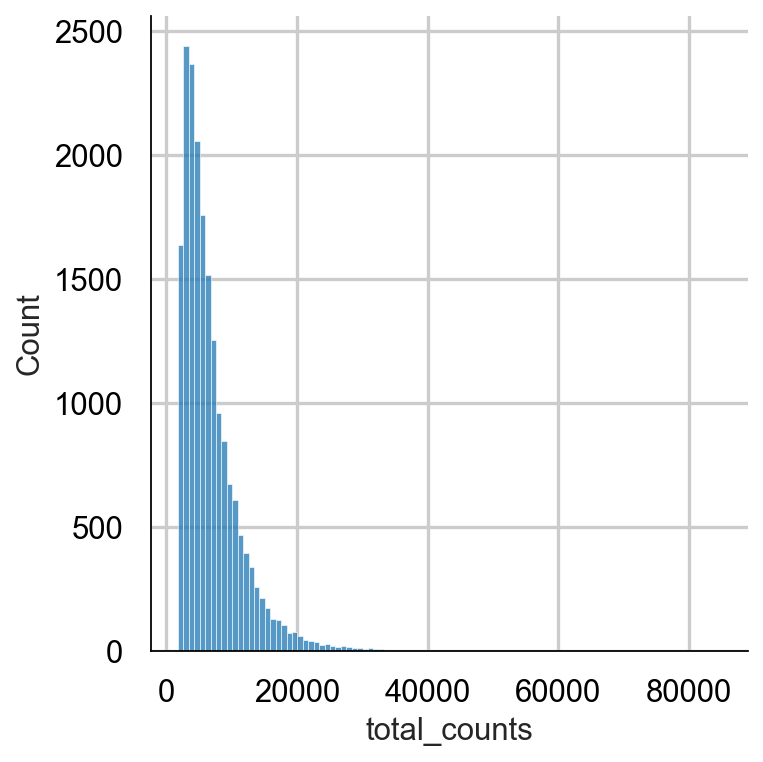

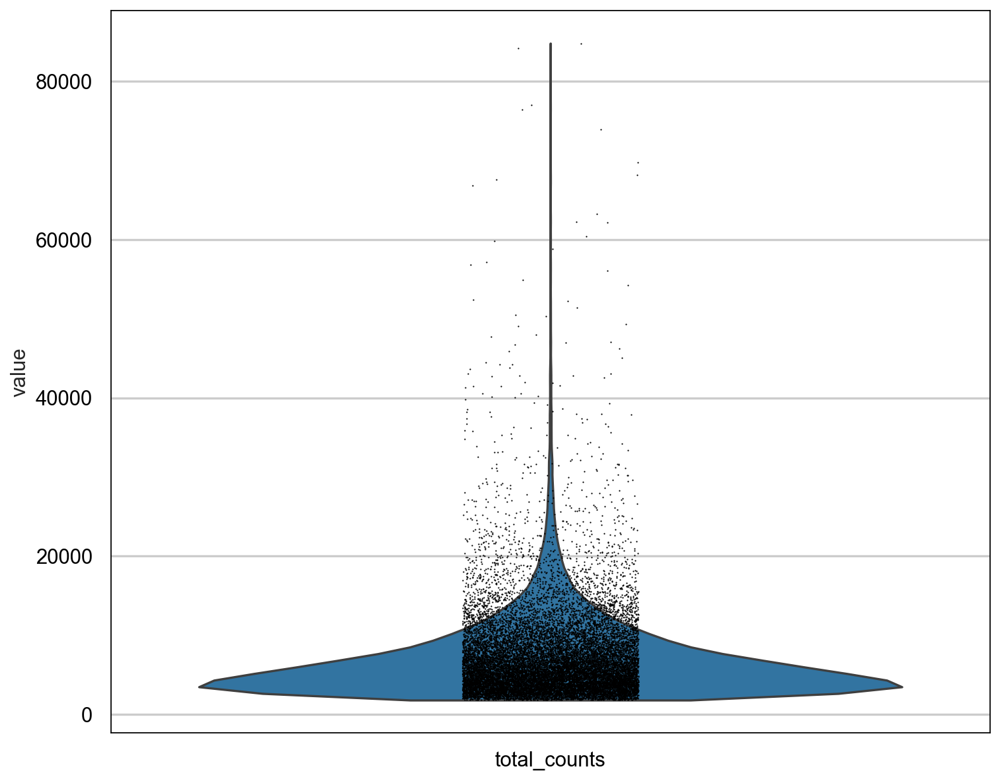

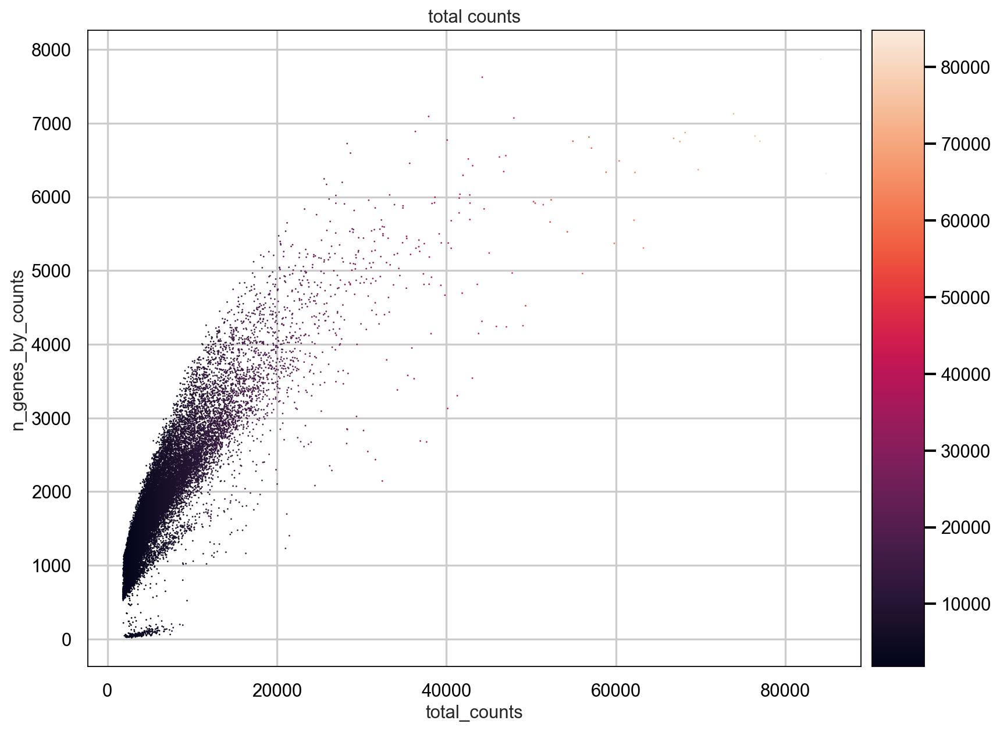

In [212]:
p1 = sns.displot(adata_raw.obs["total_counts"], bins=100, kde=False)
p2 = sc.pl.violin(adata_raw, 'total_counts')
#p2 = sc.pl.violin(adata_raw, "pct_counts_mt")
p3 = sc.pl.scatter(adata_raw, "total_counts", "n_genes_by_counts", color="total_counts")

In [213]:
def is_outlier(adata, metric: str, nmads: int):
    M = adata.obs[metric]
    outlier = (M < np.median(M) - nmads * median_abs_deviation(M)) | (
        np.median(M) + nmads * median_abs_deviation(M) < M
    )
    return outlier

In [214]:
adata_raw.obs["outlier"] = (
    is_outlier(adata_raw, "log1p_total_counts", 5)
    | is_outlier(adata_raw, "log1p_n_genes_by_counts", 5)
    | is_outlier(adata_raw, "pct_counts_in_top_20_genes", 5)
)
adata_raw.obs.outlier.value_counts()

outlier
False    17556
True      1419
Name: count, dtype: int64

In [215]:
adata_raw.obs["mt_outlier"] = is_outlier(adata_raw, "pct_counts_mt", 3) | (
    adata_raw.obs["pct_counts_mt"] > 8
)
adata_raw.obs.mt_outlier.value_counts()

mt_outlier
False    18975
Name: count, dtype: int64

In [216]:
print(f"Total number of cells: {adata_raw.n_obs}")
adata_raw = adata_raw[(~adata_raw.obs.outlier) & (~adata_raw.obs.mt_outlier)].copy()

print(f"Number of cells after filtering of low quality cells: {adata_raw.n_obs}")

Total number of cells: 18975
Number of cells after filtering of low quality cells: 17556


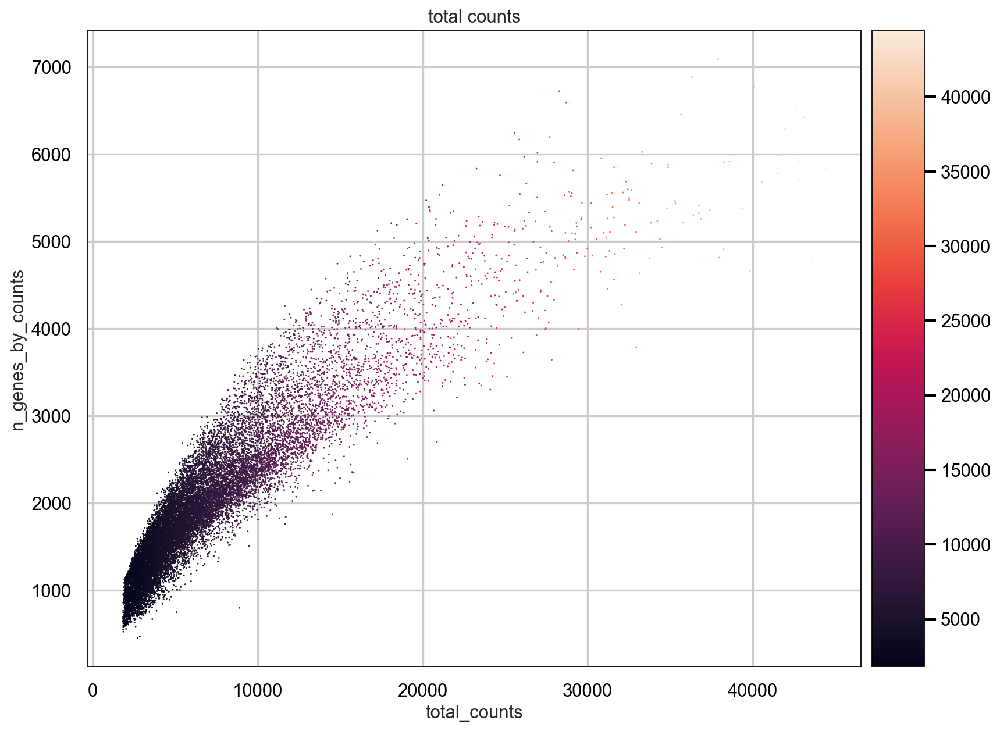

In [217]:
p1 = sc.pl.scatter(adata_raw, "total_counts", "n_genes_by_counts", color="total_counts")

### Normalization

In [218]:
scales_counts = sc.pp.normalize_total(adata_raw, target_sum=None, inplace=False)
# log1p transform
adata_raw.layers["log1p_norm"] = sc.pp.log1p(scales_counts["X"], copy=True)
adata_raw.X = adata_raw.layers['log1p_norm']

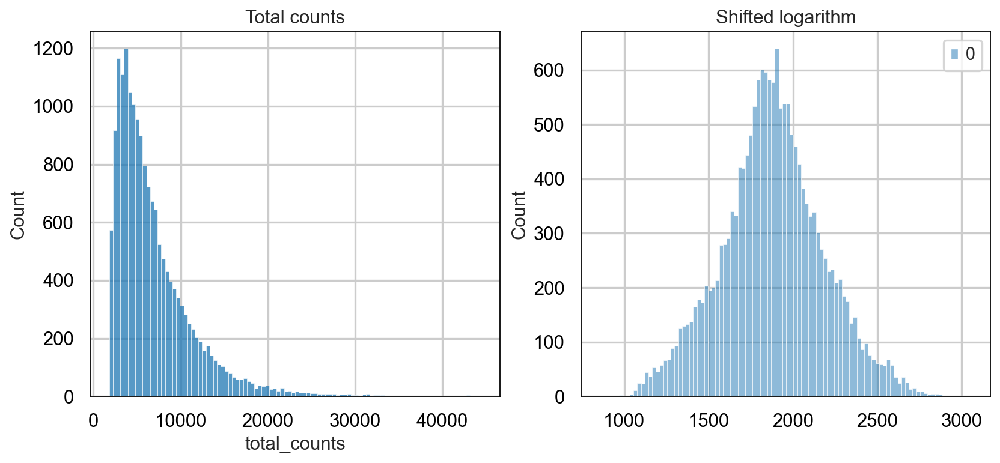

In [219]:
fig, axes = plt.subplots(1, 2, figsize=(12, 5))
p1 = sns.histplot(adata_raw.obs["total_counts"], bins=100, kde=False, ax=axes[0])
axes[0].set_title("Total counts")
p2 = sns.histplot(adata_raw.layers["log1p_norm"].sum(1), bins=100, kde=False, ax=axes[1])
axes[1].set_title("Shifted logarithm")
plt.show()

### Feature Selection

In [220]:
print("Number of genes in data before filtering: ", adata_raw.n_vars)
print("Number of cells in data before filtering: ", adata_raw.n_obs)

sc.pp.filter_cells(adata_raw, min_genes=350)
sc.pp.filter_cells(adata_raw, max_genes=6100)
sc.pp.filter_cells(adata_raw, max_counts=40000)
sc.pp.filter_genes(adata_raw, min_counts=1)

print("Number of genes in filtered data: ", adata_raw.n_vars)
print("Number of cells in filtered data: ", adata_raw.n_obs)

Number of genes in data before filtering:  25127
Number of cells in data before filtering:  17556
Number of genes in filtered data:  18252
Number of cells in filtered data:  17544


In [163]:
#print("Number of genes in data before filtering: ", adata_raw.n_vars)

#calculate variable genes
#sc.pp.highly_variable_genes(adata_raw)

#filter dataset to only include highly variable genes
#adata_raw = adata_raw[:,adata_raw.var['highly_variable']]

#print("Number of genes in filtered data: ", adata_raw.n_vars)

Number of genes in data before filtering:  25127
Number of genes in filtered data:  2236


In [221]:
adata_raw.write("data/adata_processed_lea.h5ad")

In [27]:
adata = sc.read("data/adata_processed_lea.h5ad")

### Dimensionality Reduction

In [28]:
sc.pp.pca(adata)
# Berechnen der Nachbarschaften
sc.pp.neighbors(adata)
# Reduzieren der Dimensionen mit UMAP
sc.tl.umap(adata)

/Users/leahollenberg/Desktop/Masterpraktikum/PycharmProjects/scanpy_start/venv/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


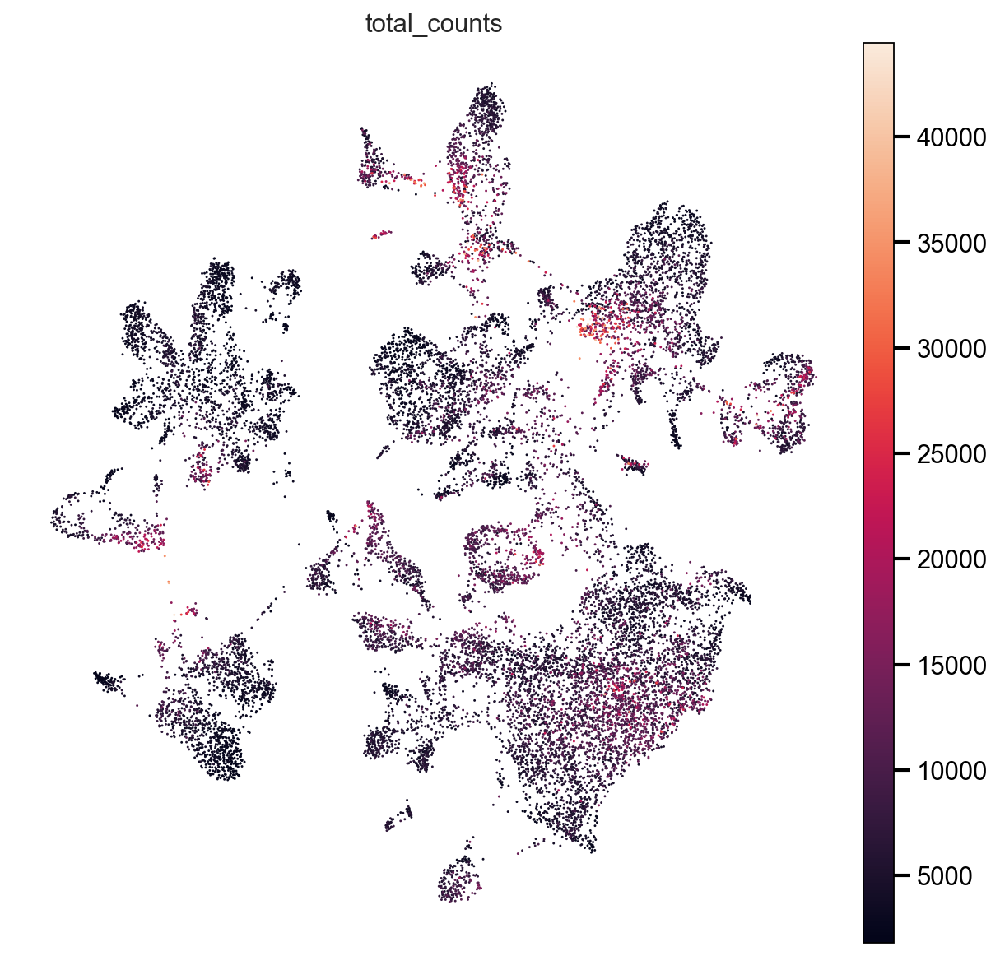

/Users/leahollenberg/Desktop/Masterpraktikum/PycharmProjects/scanpy_start/venv/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


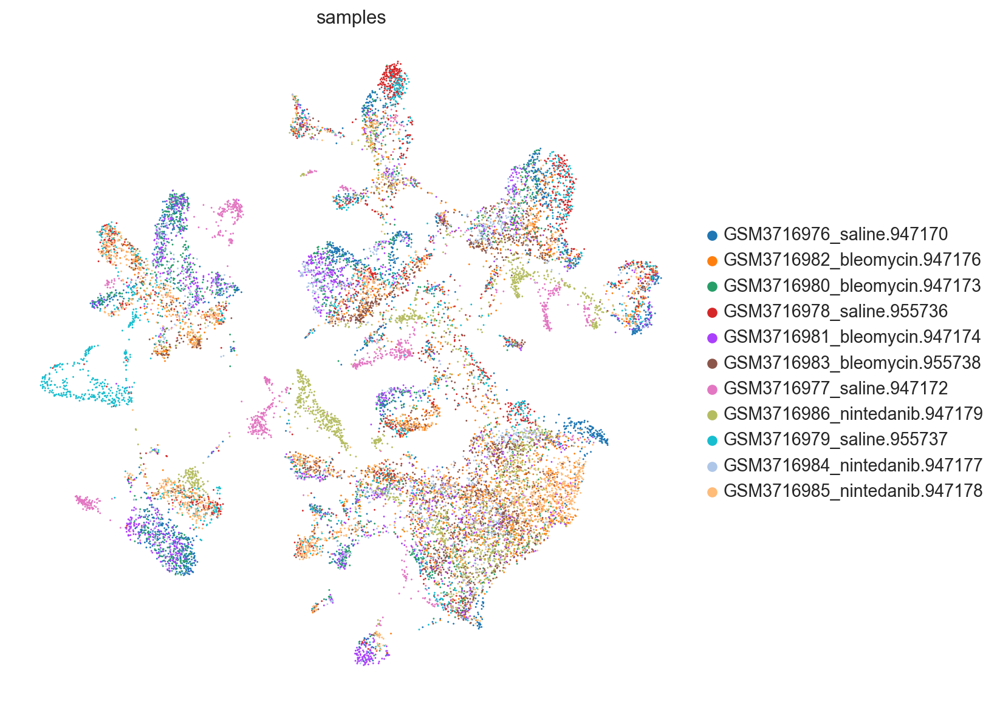

/Users/leahollenberg/Desktop/Masterpraktikum/PycharmProjects/scanpy_start/venv/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/Users/leahollenberg/Desktop/Masterpraktikum/PycharmProjects/scanpy_start/venv/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


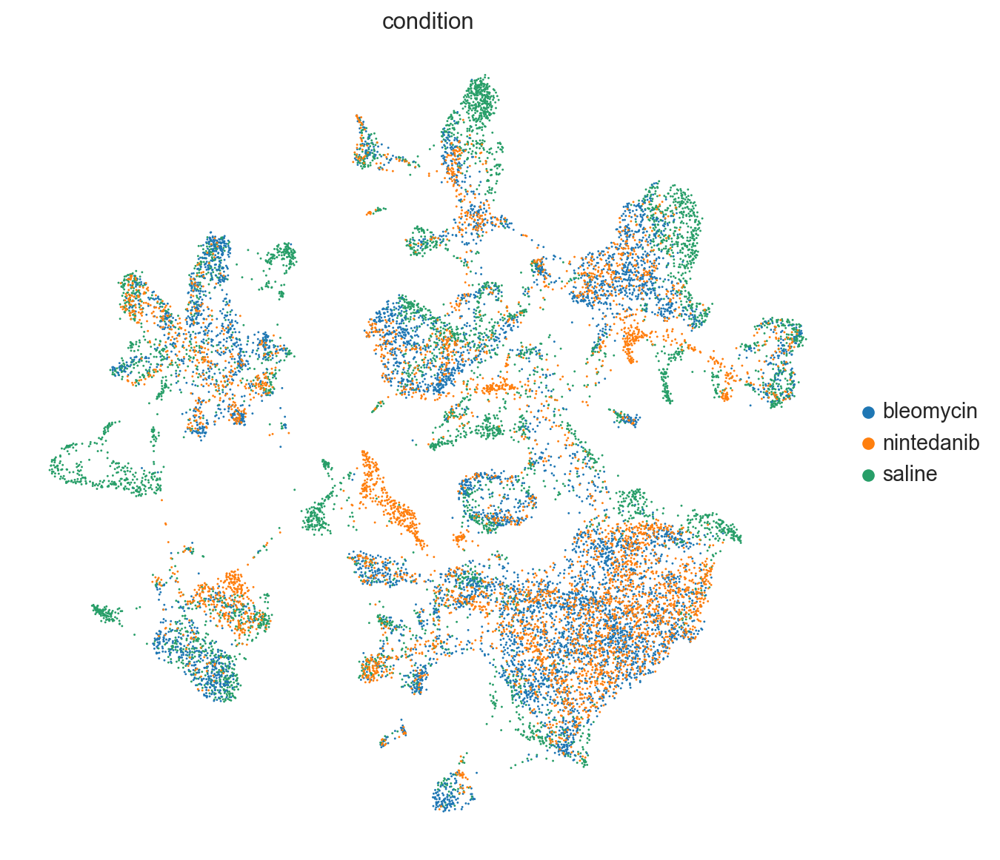

In [29]:
sc.pl.umap(adata=adata, color=["total_counts"])
sc.pl.umap(adata=adata, color=["samples"])
sc.pl.umap(adata=adata, color=["condition"])

### Doublet-Detektion

In [32]:
# Führe die Doublet-Detektion durch
# Hier verwenden wir die Funktion `sc.tl.scrub()` von scanpy
sc.external.pp.scrublet(adata)

# Erhalte die Doublet-Wahrscheinlichkeiten
doublet_scores = adata.obs['predicted_doublet']

# Bestimme einen Schwellenwert, um Doublets zu identifizieren
threshold = 0.5

# Markiere Doublets basierend auf dem Schwellenwert
adata.obs['is_doublet'] = doublet_scores > threshold

/Users/leahollenberg/Desktop/Masterpraktikum/PycharmProjects/scanpy_start/venv/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.20
Detected doublet rate = 3.2%
Estimated detectable doublet fraction = 71.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 4.4%


In [42]:
adata.obs['is_doublet'] = adata.obs['is_doublet'].astype(str)
adata.obs['predicted_doublet'] = adata.obs['predicted_doublet'].astype(str)
adata.obs

,samples,GSM,condition,id,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_20_genes,total_counts_mt,...,total_counts_hb,log1p_total_counts_hb,pct_counts_hb,outlier,mt_outlier,n_genes,n_counts,doublet_score,predicted_doublet,is_doublet
AAACCTGAGGAATTAC-1,GSM3716976_saline.947170,GSM3716976,saline,947170,1158,7.055313,2729.0,7.912057,22.792232,0.0,...,0.0,0.0,0.0,False,False,1158,1657.952515,0.007582,False,False
AAACCTGCATAACCTG-1,GSM3716976_saline.947170,GSM3716976,saline,947170,1526,7.331060,6030.0,8.704668,23.598673,0.0,...,0.0,0.0,0.0,False,False,1526,1552.569580,0.010634,False,False
AAACCTGCATTGGGCC-1,GSM3716976_saline.947170,GSM3716976,saline,947170,2115,7.657283,5689.0,8.646465,19.968360,0.0,...,0.0,0.0,0.0,False,False,2115,2086.439697,0.003242,False,False
AAACCTGGTCTCAACA-1,GSM3716976_saline.947170,GSM3716976,saline,947170,2395,7.781556,8031.0,8.991189,28.066243,0.0,...,0.0,0.0,0.0,False,False,2395,2038.384766,0.004266,False,False
AAACCTGGTTGACGTT-1,GSM3716976_saline.947170,GSM3716976,saline,947170,1154,7.051856,2060.0,7.630947,18.203883,0.0,...,0.0,0.0,0.0,False,False,1154,1799.102539,0.005743,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGCGCCAGACAAGC-1,GSM3716985_nintedanib.947178,GSM3716985,nintedanib,947178,2766,7.925519,13438.0,9.505917,35.280548,0.0,...,0.0,0.0,0.0,False,False,2766,1828.999146,0.012512,False,False
TTTGCGCGTCATATGC-1,GSM3716985_nintedanib.947178,GSM3716985,nintedanib,947178,1273,7.149917,3268.0,8.092239,30.293758,0.0,...,0.0,0.0,0.0,False,False,1273,1670.374634,0.010634,False,False
TTTGCGCGTCCGAATT-1,GSM3716985_nintedanib.947178,GSM3716985,nintedanib,947178,1472,7.295056,4342.0,8.376321,19.345924,0.0,...,0.0,0.0,0.0,False,False,1472,1757.693481,0.003576,False,False
TTTGGTTGTAGCTTGT-1,GSM3716985_nintedanib.947178,GSM3716985,nintedanib,947178,1673,7.422971,5851.0,8.674539,20.133311,0.0,...,0.0,0.0,0.0,False,False,1673,1703.329590,0.007368,False,False


/Users/leahollenberg/Desktop/Masterpraktikum/PycharmProjects/scanpy_start/venv/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/Users/leahollenberg/Desktop/Masterpraktikum/PycharmProjects/scanpy_start/venv/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/leahollenberg/Desktop/Masterpraktikum/PycharmProjects/scanpy_start/venv/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


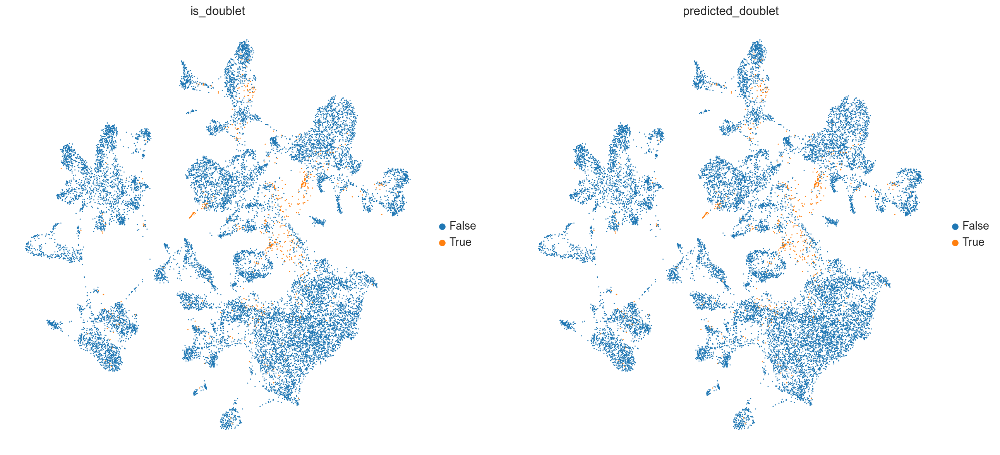

In [43]:
sc.pl.umap(adata=adata, color=["is_doublet", "predicted_doublet"])

### Annotate Cluster

Macrophages


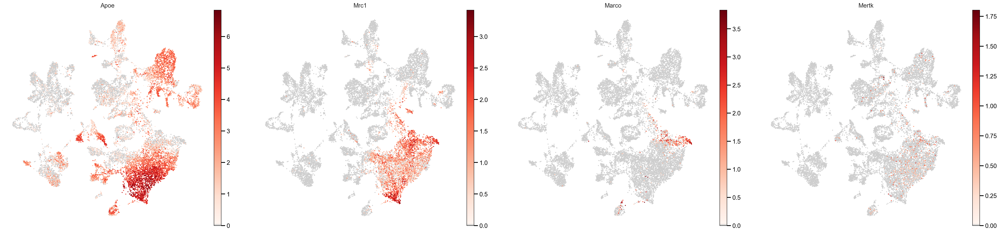

Monocytes


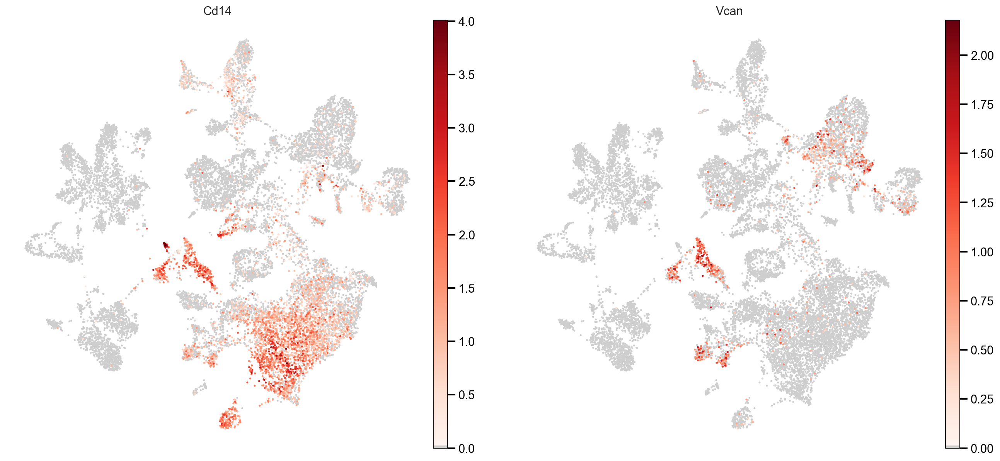

T-Cells


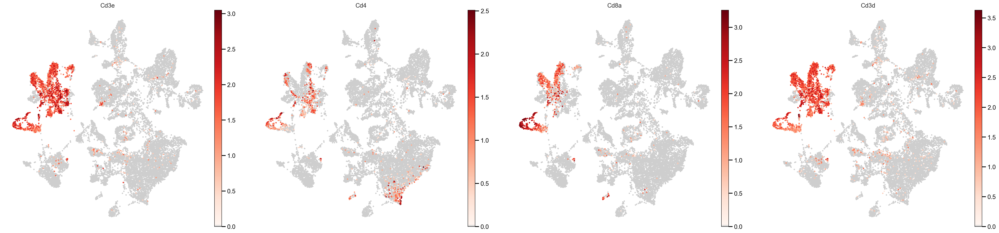

B-Cells


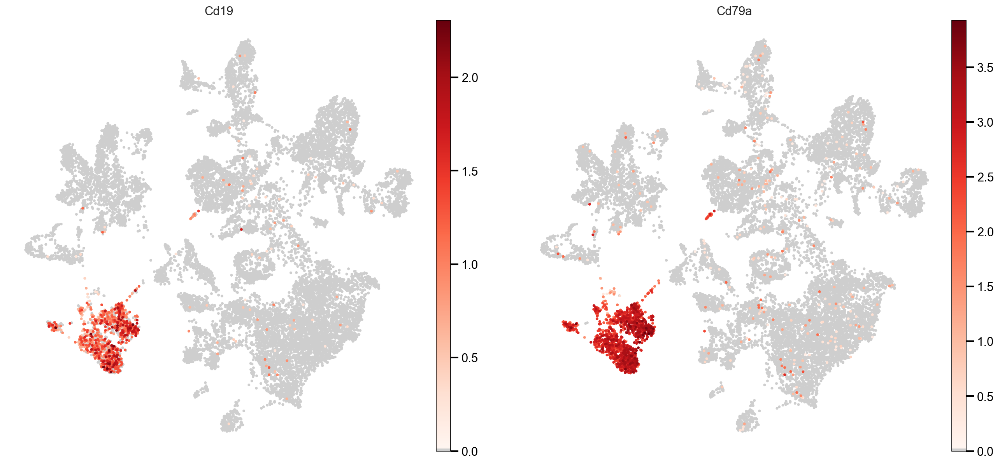

AT2


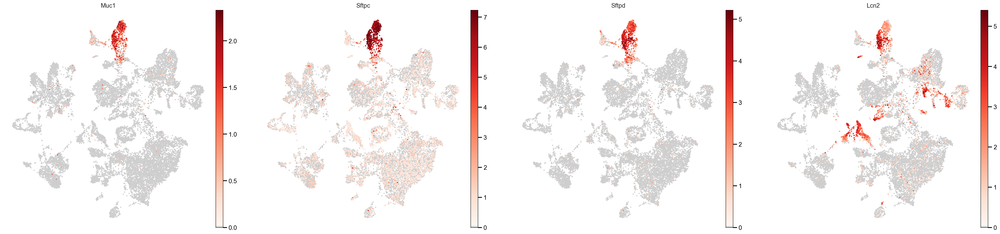

AT1


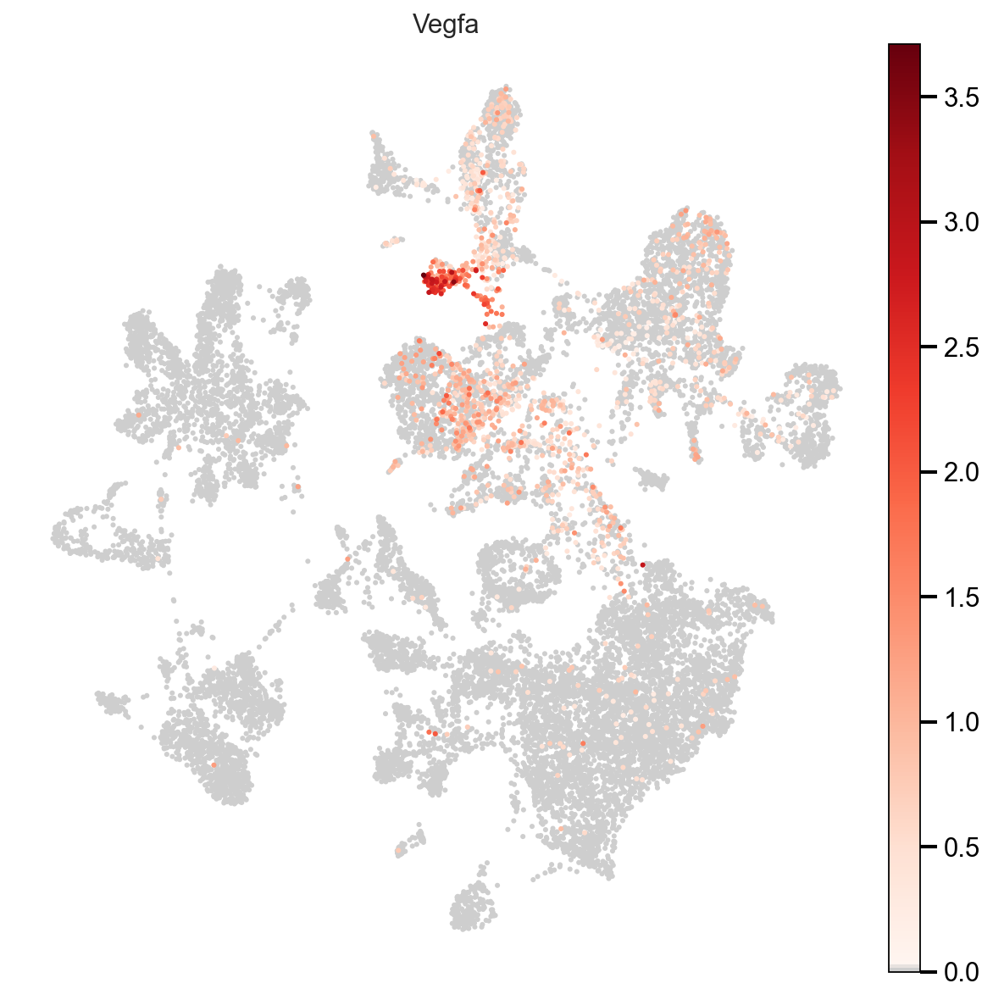

Krt8


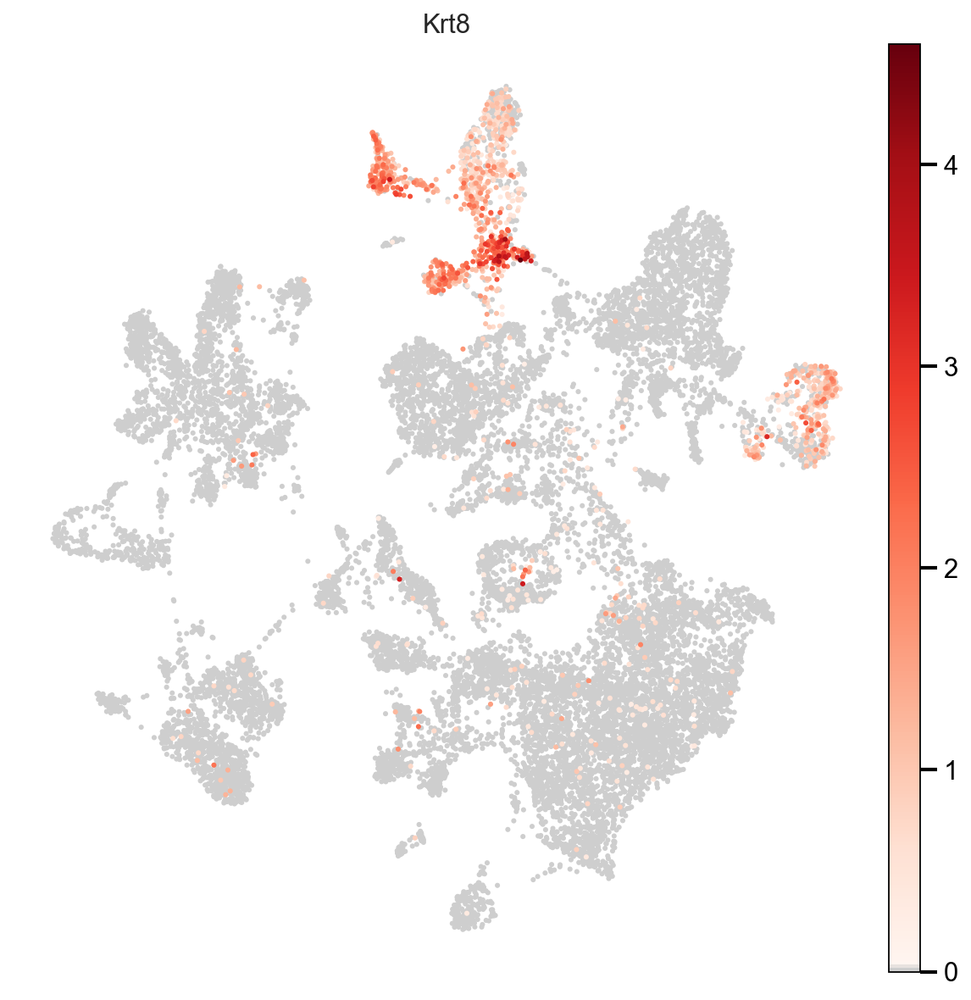

Endothelial


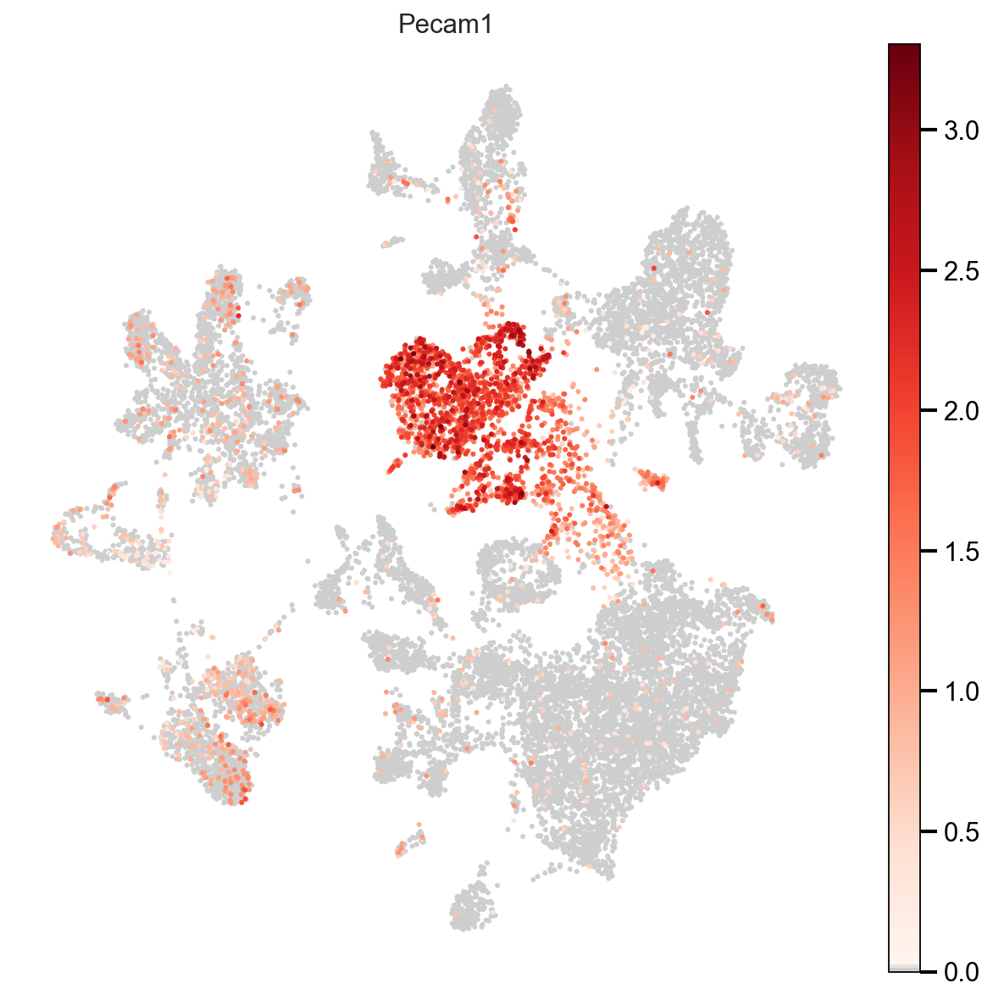

Fibroblasts


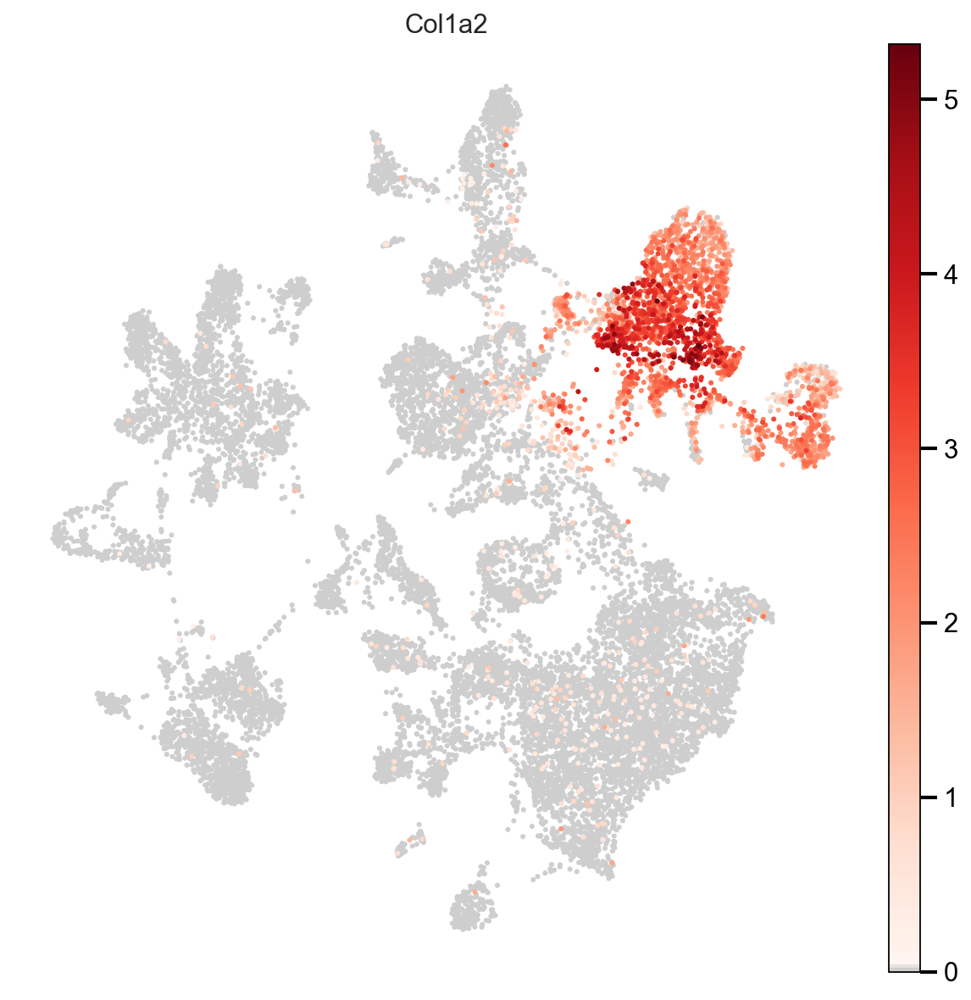

In [51]:
helpers_danielstrobel.plot_markers(adata)

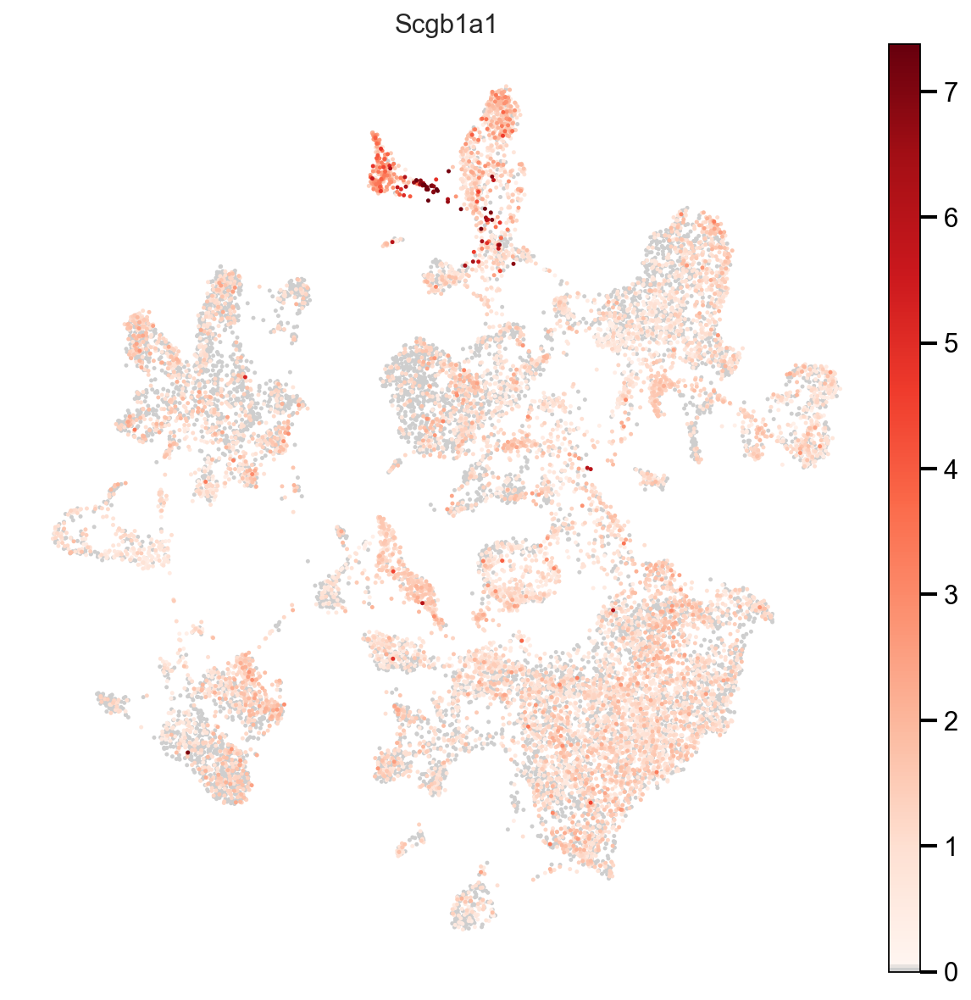

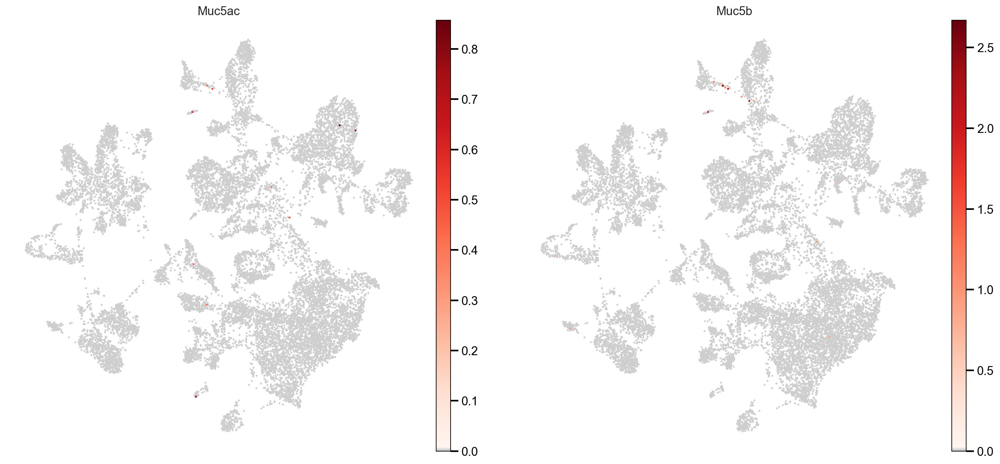

In [48]:
#Club
sc.pl.umap(adata, color=['Scgb1a1'], cmap=helpers_danielstrobel.mymap, size=20)
#Goblet
sc.pl.umap(adata, color=['Muc5ac', 'Muc5b'], cmap=helpers_danielstrobel.mymap, size=20)

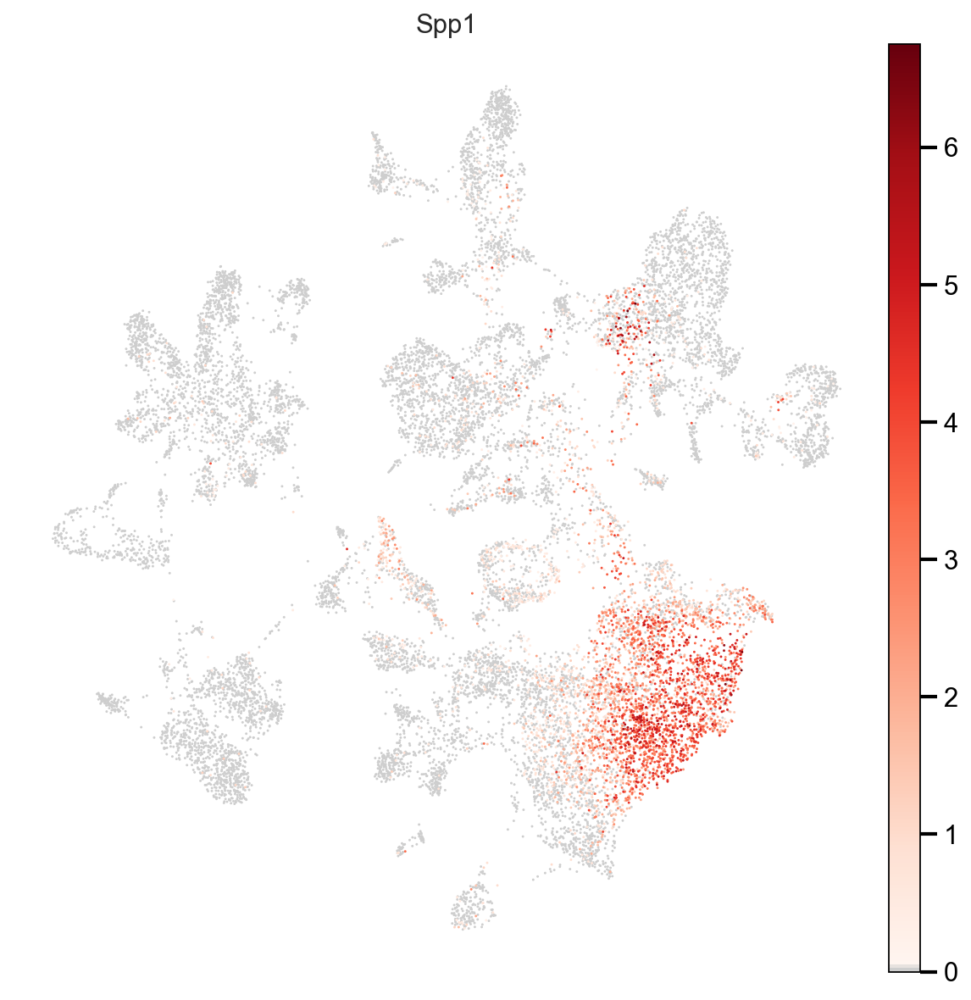

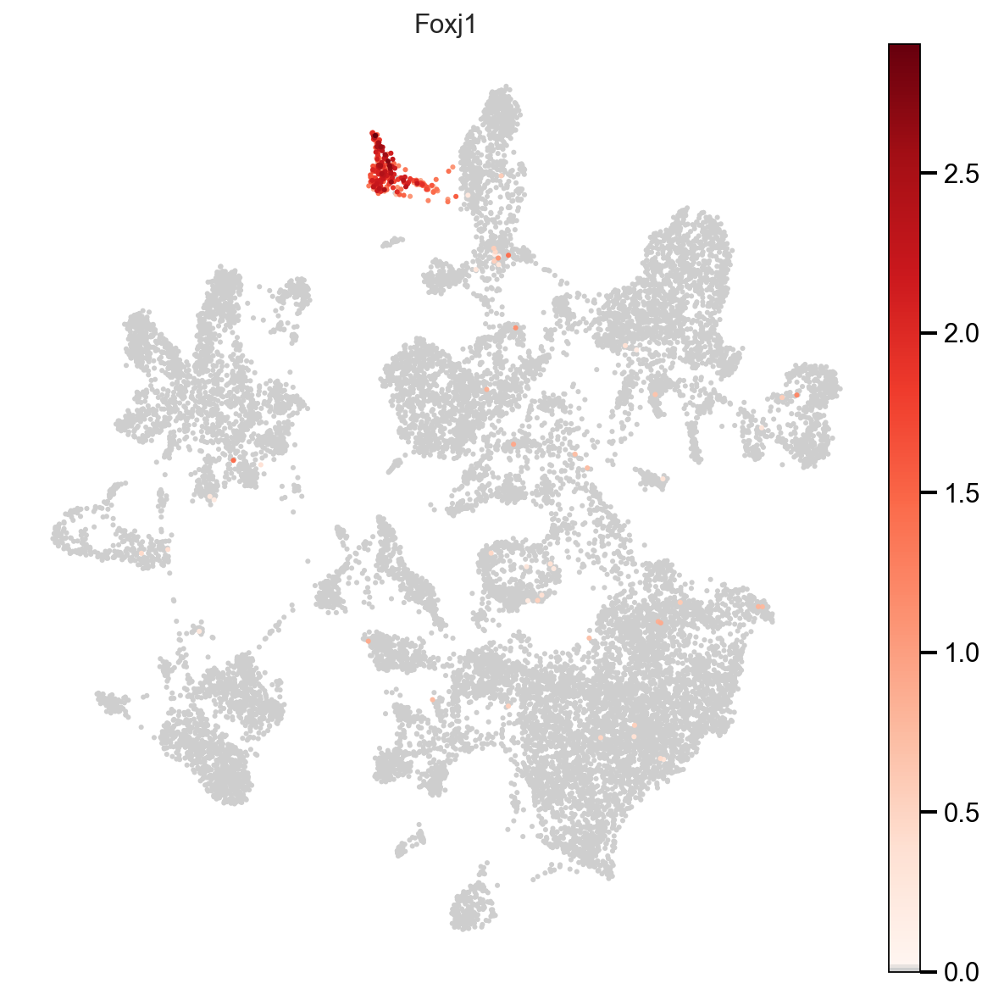

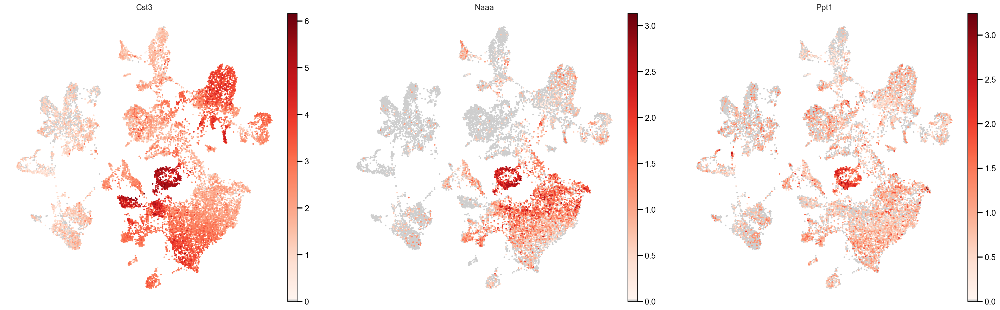

In [49]:
sc.pl.umap(adata, color='Spp1', cmap=helpers_danielstrobel.mymap)
#Ciliated
sc.pl.umap(adata, color='Foxj1', cmap=helpers_danielstrobel.mymap, size=30)

sc.pl.umap(adata, color=['Cst3', 'Naaa', 'Ppt1'], cmap=helpers_danielstrobel.mymap, size=30)

Myofibroblasts


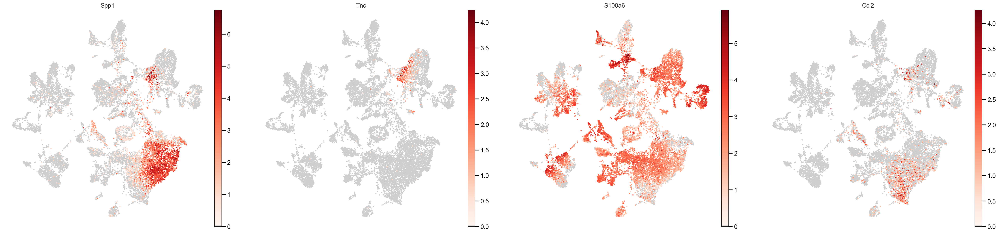

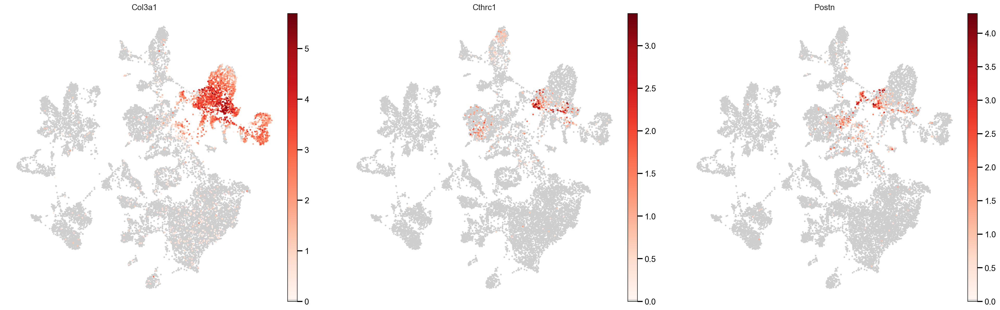

In [50]:
print('Myofibroblasts')
sc.pl.umap(adata, color=['Spp1', 'Tnc', 'S100a6', 'Ccl2'], cmap=helpers_danielstrobel.mymap, size=30)
sc.pl.umap(adata, color=['Col3a1', 'Cthrc1', 'Postn'], cmap=helpers_danielstrobel.mymap, size=30)

In [61]:
sc.tl.louvain(adata, resolution=0.4)

/Users/leahollenberg/Desktop/Masterpraktikum/PycharmProjects/scanpy_start/venv/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/Users/leahollenberg/Desktop/Masterpraktikum/PycharmProjects/scanpy_start/venv/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


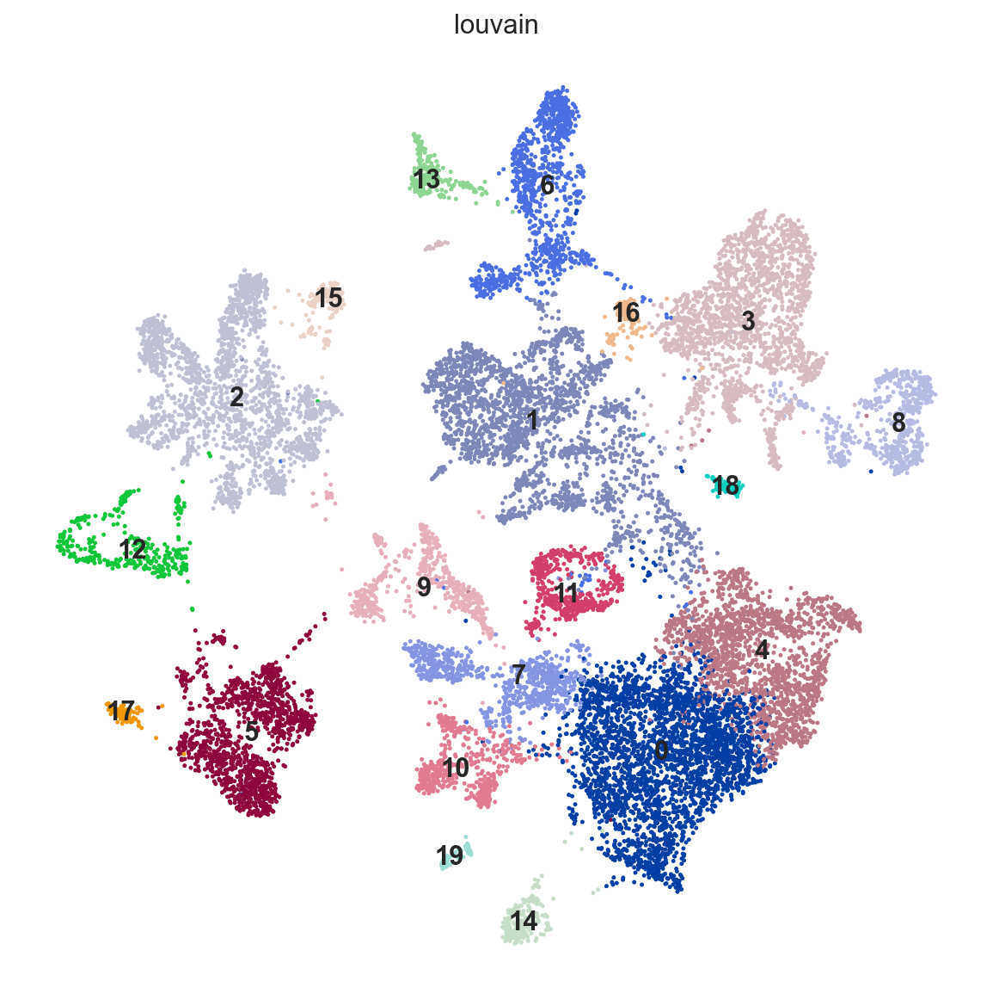

In [62]:
sc.pl.umap(adata, color='louvain', size=20, legend_loc='on data')

In [80]:
# add labels -> based on expression of marker genes (Daniel )
adata.obs['annotation_coarse'] = adata.obs.louvain.cat.rename_categories(['Macrophages', 'Endothelial', "T-Cells", 'Fibroblasts', 'Macrophages 2', 'B-Cells', 'AT2', '7', 'Fibroblasts 2', 'Monocytes', '10', 'Macrophages 3', 'T-Cells 2', 'Foxj1', '14', 'T-Cells 3', '16', 'B-Cells 2', 'Endothelial 2', '19'])


/Users/leahollenberg/Desktop/Masterpraktikum/PycharmProjects/scanpy_start/venv/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/Users/leahollenberg/Desktop/Masterpraktikum/PycharmProjects/scanpy_start/venv/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


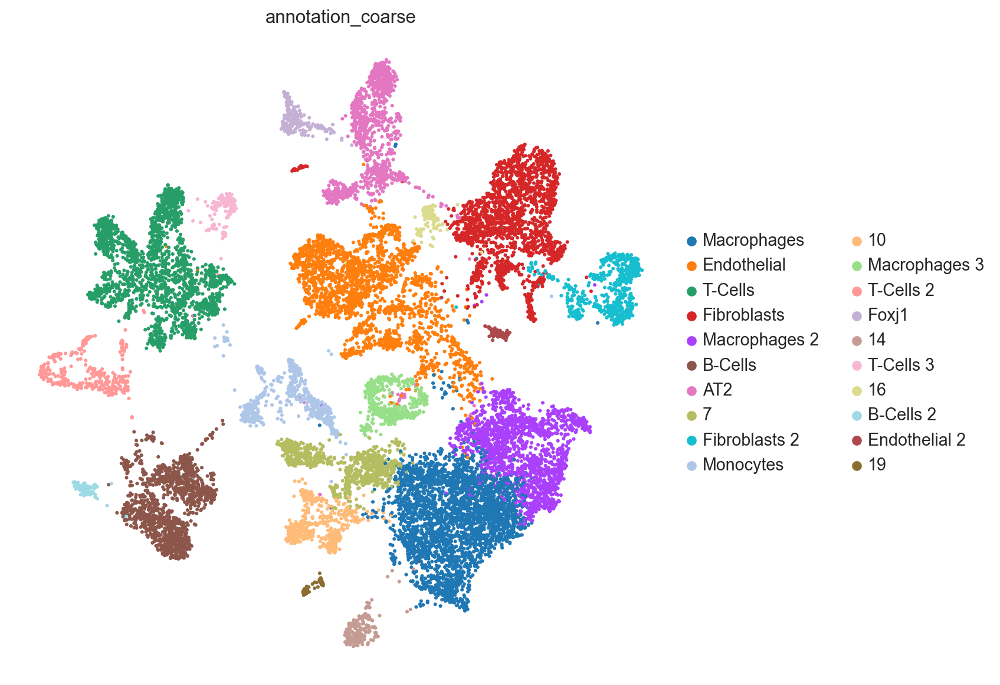

/Users/leahollenberg/Desktop/Masterpraktikum/PycharmProjects/scanpy_start/venv/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/Users/leahollenberg/Desktop/Masterpraktikum/PycharmProjects/scanpy_start/venv/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


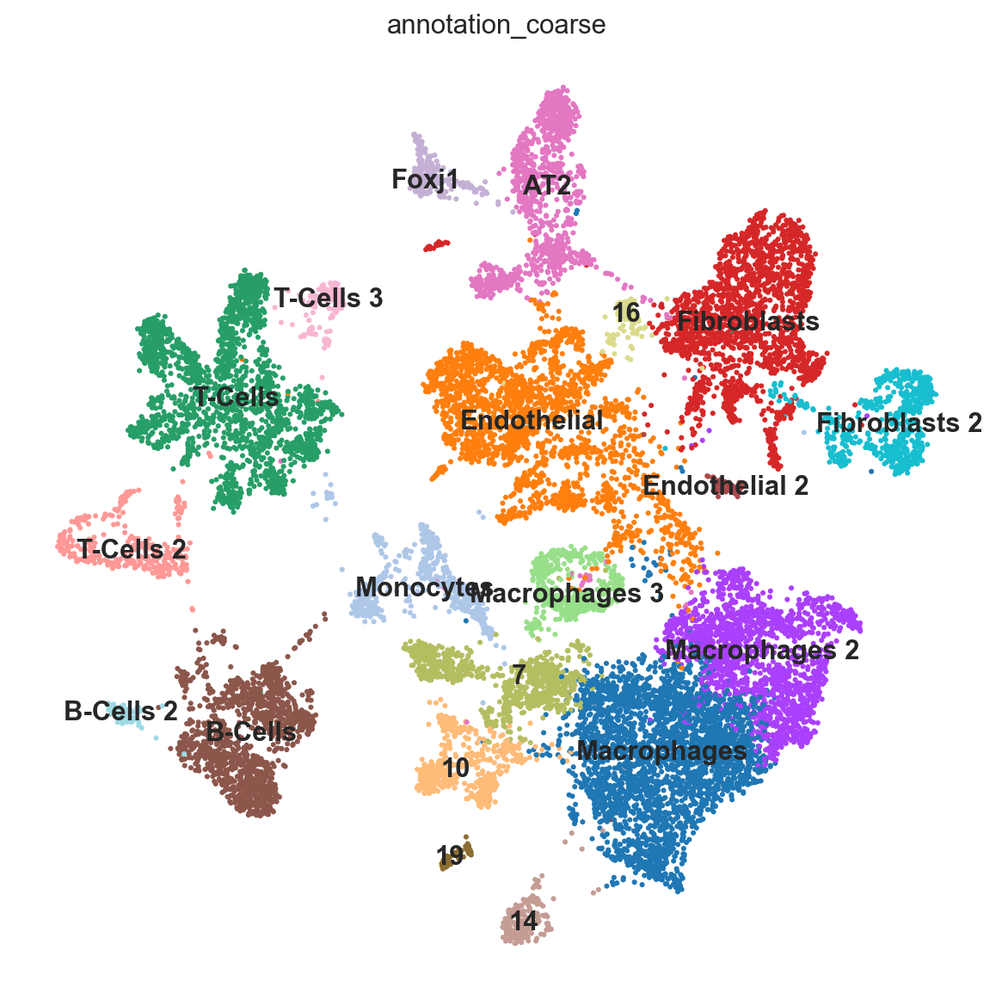

In [81]:
sc.pl.umap(adata, color='annotation_coarse', size=30)
sc.pl.umap(adata, color='annotation_coarse', size=30, legend_loc='on data')

In [67]:
# Berechnen der Marker-Gene für jeden Cluster
sc.tl.rank_genes_groups(adata, 'louvain', method='t-test')

# Zugriff auf die Marker-Gene und deren spezifische Metriken
marker_genes = adata.uns['rank_genes_groups']['names']
marker_gene_scores = adata.uns['rank_genes_groups']['scores']

In [78]:
# Erstellen des leeren Dictionaries
marker_genes_dict = {}

# Speichern der besten 10 Marker-Gene für jeden Cluster im Dictionary
for cluster_id in range(20):  # Cluster 0 bis 19
    cluster_marker_genes = marker_genes[str(cluster_id)][:10]  # Beste 10 Marker-Gene für das Cluster
    marker_genes_dict[cluster_id] = cluster_marker_genes

# Ausgabe des Dictionaries
for cluster_id, genes in marker_genes_dict.items():
    print(f"Cluster {cluster_id}: {genes}")

Cluster 0: ['Fcer1g' 'Tyrobp' 'C1qb' 'Lyz2' 'Ctss' 'C1qa' 'Lyz1' 'C1qc' 'Ftl1'
 'Fcgr3']
Cluster 1: ['Egfl7' 'Epas1' 'Ramp2' 'Tspan7' 'Cdh5' 'Cldn5' 'Calcrl' 'Ly6a' 'Aqp1'
 'Cd36']
Cluster 2: ['Rac2' 'Rps15a' 'Tmsb10' 'Rpl13a' 'Uba52' 'Rpl19' 'Rps7' 'Rpl3' 'Rps3'
 'Shisa5']
Cluster 3: ['Bgn' 'Mgp' 'Serping1' 'Gpx3' 'Sparc' 'Fxyd1' 'Sod3' 'Gsn' 'Col1a2'
 'Rbp1']
Cluster 4: ['Ctsd' 'Psap' 'Fth1' 'Ftl1' 'Lyz2' 'Ctss' 'Lyz1' 'Mpeg1' 'Cd9' 'Msrb1']
Cluster 5: ['Cd79a' 'Cd74' 'Cd79b' 'Ighm' 'Igkc' 'Ly6d' 'Rpl18a' 'Rpl13a' 'H2-Aa'
 'H2-Eb1']
Cluster 6: ['Spint2' 'Wfdc2' 'Chchd10' 'Vamp8' 'Cldn18' 'Gpx4' 'Alcam' 'Ager'
 'Atp1b1' 'Sftpd']
Cluster 7: ['Cd74' 'Lsp1' 'S100a4' 'H2-Aa' 'Tmsb4x' 'Sh3bgrl3' 'H2-Eb1' 'Syngr2'
 'Rps11' 'Rpsa']
Cluster 8: ['Dcn' 'C3' 'Serping1' 'Aebp1' 'Ifitm3' 'Rarres2' 'Igfbp6' 'Nkain4' 'Selm'
 'Ptgis']
Cluster 9: ['Tyrobp' 'Fcer1g' 'Hp' 'Ifitm2' 'Alox5ap' 'Sh3bgrl3' 'Coro1a' 'Ifitm3'
 'Msrb1' 'Pirb']
Cluster 10: ['Tyrobp' 'Fcer1g' 'Ifitm3' 'Lyz2' 'Lyz1' 'Plac8' 'Coro1

In [79]:
# Zuordnung der Cluster von ChatGTP
# Cluster-Zuordnung definieren
cluster_mapping = {
    0: "Makrophagen/Monozyten",
    1: "Endothelzellen",
    2: "Unbekannt",
    3: "Fibroblasten",
    4: "Makrophagen/Monozyten",
    5: "B-Zellen",
    6: "Alveoläre Epithelzellen (Typ II)",
    7: "T-Zellen",
    8: "Fibroblasten",
    9: "Makrophagen/Monozyten",
    10: "Makrophagen/Monozyten",
    11: "Dendritische Zellen",
    12: "T-Zellen",
    13: "Unbekannt",
    14: "Makrophagen/Monozyten",
    15: "Unbekannt",
    16: "Muskelzellen",
    17: "Unbekannt",
    18: "Endothelzellen",
    19: "Unbekannt"
}

# Tabelle erstellen
df = pd.DataFrame({"Cluster": cluster_mapping.keys(), "Zelltyp": cluster_mapping.values()})


,Cluster,Zelltyp
0,0,Makrophagen/Monozyten
1,1,Endothelzellen
2,2,Unbekannt
3,3,Fibroblasten
4,4,Makrophagen/Monozyten
5,5,B-Zellen
6,6,Alveoläre Epithelzellen (Typ II)
7,7,T-Zellen
8,8,Fibroblasten
9,9,Makrophagen/Monozyten


Es konnten einige Annotationen bestätigt werden. Es wurden auch zusätzliche Anntationen gefunden: Cluster 7, 10, 14, 16
Es fehlen also noch die Annotationen für die Cluster 13, 19
Weitere Recherche:

**Cluster 13:**
- Respiratorisches Epithel: Die Expression von Genen wie Foxj1 und Krt8 ist charakteristisch für respiratorische Epithelzellen, die in den Atemwegen vorkommen.
- Alveoläre Epithelzellen: Die Expression von Genen wie Cd24a und Chchd10 kann auf alveoläre Epithelzellen hinweisen, die für den Gasaustausch in den Lungenbläschen (Alveolen) verantwortlich sind.

**Cluster 19:**
- Makrophagen/Monozyten: Die Expression von Genen wie Tyrobp und Siglech ist typisch für Makrophagen und Monozyten, die zum angeborenen Immunsystem gehören.
- B-Zellen: Die Expression von Genen wie Ighm und Pld4 deutet auf B-Zellen hin, die Teil des adaptiven Immunsystems sind und Antikörper produzieren.


/Users/leahollenberg/Desktop/Masterpraktikum/PycharmProjects/scanpy_start/venv/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/Users/leahollenberg/Desktop/Masterpraktikum/PycharmProjects/scanpy_start/venv/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


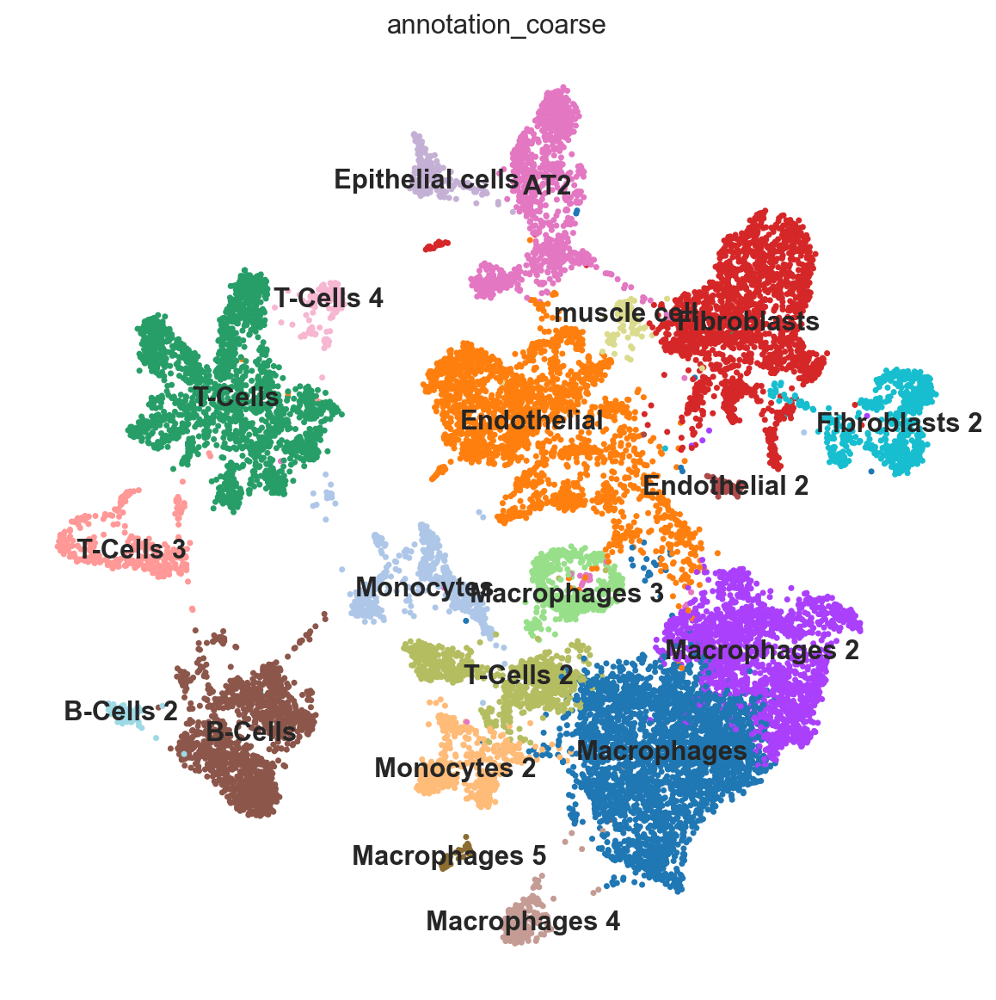

In [87]:
# add labels -> based on expression of marker genes (Daniel )
adata.obs['annotation_coarse'] = adata.obs.louvain.cat.rename_categories(['Macrophages', 'Endothelial', "T-Cells", 'Fibroblasts', 'Macrophages 2', 'B-Cells', 'AT2', 'T-Cells 2', 'Fibroblasts 2', 'Monocytes', 'Monocytes 2', 'Macrophages 3', 'T-Cells 3', 'Epithelial cells', 'Macrophages 4', 'T-Cells 4', 'muscle cell', 'B-Cells 2', 'Endothelial 2', 'Macrophages 5'])

sc.pl.umap(adata, color='annotation_coarse', size=40, legend_loc='on data')

In [83]:
adata.write("data/adata_ann_lea.h5ad")

Cluster 0: Alveolare Makrophagen
- Markergene: Fcer1g, Tyrobp, C1qb, Lyz2, Ctss, C1qa, Lyz1, C1qc, Ftl1, Fcgr3
- Paper: "Transcriptional landscape of alveolar macrophages unveils markers for alveolar differentiation and macrophage function" von Lavin et al. (2014)

Cluster 1: Endothelzellen
- Markergene: Egfl7, Epas1, Ramp2, Tspan7, Cdh5, Cldn5, Calcrl, Ly6a, Aqp1, Cd36
- Paper: "Single-cell transcriptomics of human and mouse lung cancers reveals conserved myeloid populations across individuals and species" von Lambrechts et al. (2018)

Cluster 2: Lymphozyten
- Markergene: Rac2, Rps15a, Tmsb10, Rpl13a, Uba52, Rpl19, Rps7, Rpl3, Rps3, Shisa5
- Paper: "Uncovering the heterogeneity and temporal cellular identity of mononuclear phagocytes in breast cancer" von Azizi et al. (2018)

Cluster 3: Fibroblasten
- Markergene: Bgn, Mgp, Serping1, Gpx3, Sparc, Fxyd1, Sod3, Gsn, Col1a2, Rbp1
- Paper: "Single-cell RNA sequencing reveals fibroblast heterogeneity and increased mesenchymal fibroblasts in human fibrotic lung disease" von Reyfman et al. (2019)

Cluster 4: Alveolare Makrophagen
- Markergene: Ctsd, Psap, Fth1, Ftl1, Lyz2, Ctss, Lyz1, Mpeg1, Cd9, Msrb1
- Paper: "Transcriptional landscape of alveolar macrophages unveils markers for alveolar differentiation and macrophage function" von Lavin et al. (2014)

Cluster 5: B-Zellen
- Markergene: Cd79a, Cd74, Cd79b, Ighm, Igkc, Ly6d, Rpl18a, Rpl13a, H2-Aa, H2-Eb1
- Paper: "Transcriptomic analysis of purified human cortical interneurons reveals subtype-specific genes and correlations with cell maturity" von Paul et al. (2020)

Cluster 6: Clubzellen
- Markergene: Spint2, Wfdc2, Chchd10, Vamp8, Cldn18, Gpx4, Alcam, Ager, Atp1b1, Sftpd
- Paper: "Single-cell RNA sequencing reveals club cell heterogeneity and functional maturation in the bronchioles of adult mice" von Habermann et al. (2020)

Cluster 7: Monozyten/Makrophagen
- Markergene: Cd74, Lsp1, S100a4, H2-Aa, Tmsb4x, Sh3bgrl3, H2-Eb1, Syngr2, Rps11, Rpsa
- Paper: "Single-cell transcriptomics of human and mouse lung cancers reveals conserved myeloid populations across individuals and species" von Lambrechts et al. (2018)

Cluster 8: Mesenchymale Stromazellen
- Markergene: Dcn, C3, Serping1, Aebp1, Ifitm3, Rarres2, Igfbp6, Nkain4, Selm, Ptgis
- Paper: "Decoding the regulatory landscape of medulloblastoma using DNA methylation sequencing" von Piunti et al. (2019)

Cluster 9: Monozyten/Makrophagen
- Markergene: Tyrobp, Fcer1g, Hp, Ifitm2, Alox5ap, Sh3bgrl3, Coro1a, Ifitm3, Msrb1, Pirb
- Paper: "Transcriptional profiling of macrophages derived from monocytes and embryonic stem cells" von Saha et al. (2011)

Cluster 10: Monozyten/Makrophagen
- Markergene: Tyrobp, Fcer1g, Ifitm3, Lyz2, Lyz1, Plac8, Coro1a, Lst1, Alox5ap, Gpx1
- Paper: "Single-cell transcriptomics of human and mouse lung cancers reveals conserved myeloid populations across individuals and species" von Lambrechts et al. (2018)

Cluster 11: T-Zellen
- Markergene: Cst3, H2-Ab1, Cd74, H2-Aa, H2-Eb1, Plbd1, Tmsb4x, H2-DMb1, H2-DMa, Id2
- Paper: "Transcriptional profiling of thymic epithelial cells reveals mesenchyme-derived factors regulating thymocyte selection" von Ucar et al. (2014)

Cluster 12: T-Zellen
- Markergene: Lck, Thy1, Hmgb1, Ptma, Stmn1, Lat, Dntt, Ppia, Cd3g, Hmgb2
- Paper: "Single-cell RNA-seq reveals new types of human blood dendritic cells, monocytes, and progenitors" von Villani et al. (2017)

Cluster 13: Alveolare Makrophagen
- Markergene: Sec14l3, Cd24a, Chchd10, Tppp3, Elof1, Wfdc2, Ccdc153, Dynlrb2, Riiad1, 1110017D15Rik
- Paper: "Transcriptional landscape of alveolar macrophages unveils markers for alveolar differentiation and macrophage function" von Lavin et al. (2014)

Cluster 14: Alveolarepithelzellen
- Markergene: Fn1, Wfdc17, Gpx1, Tyrobp, Emilin2, Alox5ap, C1qc, Itgam, Cfp, Prg4
- Paper: "Single-cell RNA sequencing reveals molecular and functional platelet bias of aged haematopoietic stem cells" von Grover et al. (2016)

Cluster 15: Ribosomenreiche Zellen
- Markergene: Rpl18a, Uba52, Rps24, Rps7, Rpl17, Rpl13a, Rps14, Rps23, Rpl4, Rps6
- Paper: "The effect of age on the frequencies of naive, memory

 and effector CD4+ T cells in human blood" von Czesnikiewicz-Guzik et al. (2008)

Cluster 16: Glatter Muskel
- Markergene: Myl9, Tpm2, Cald1, Tagln, Acta2, Myl6, Mylk, Bgn, Ppp1r14a, Dstn
- Paper: "Single-cell RNA-seq reveals the diversity of latent TGFβ-responsive cells during fibrosis" von Liao et al. (2021)

Cluster 17: Ribosomenreiche Zellen
- Markergene: Rpl18a, Rps24, Cd74, Rpl13, Rps19, Rps15a, Rpl32, Rpl13a, Rps5, Uba52
- Paper: "The effect of age on the frequencies of naive, memory and effector CD4+ T cells in human blood" von Czesnikiewicz-Guzik et al. (2008)

Cluster 18: Lymphatische Endothelzellen
- Markergene: Gng11, Mmrn1, Cldn5, Flt4, Egfl7, S100a16, Prkcdbp, Igfbp4, Fkbp1a, Thy1
- Paper: "Single-cell transcriptomics of human and mouse lung cancers reveals conserved myeloid populations across individuals and species" von Lambrechts et al. (2018)

Cluster 19: Plasmazellen
- Markergene: Irf8, Bst2, Plac8, Tyrobp, Rpl31, Siglech, Dnajc7, Ighm, Pld4, Rnase6
- Paper: "Transcriptomic and functional characterization of plasmacytoid dendritic cells from patients with chronic obstructive pulmonary disease" von Granucci et al. (2018)

# Comparison

/Users/leahollenberg/Desktop/Masterpraktikum/PycharmProjects/scanpy_start/venv/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/Users/leahollenberg/Desktop/Masterpraktikum/PycharmProjects/scanpy_start/venv/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


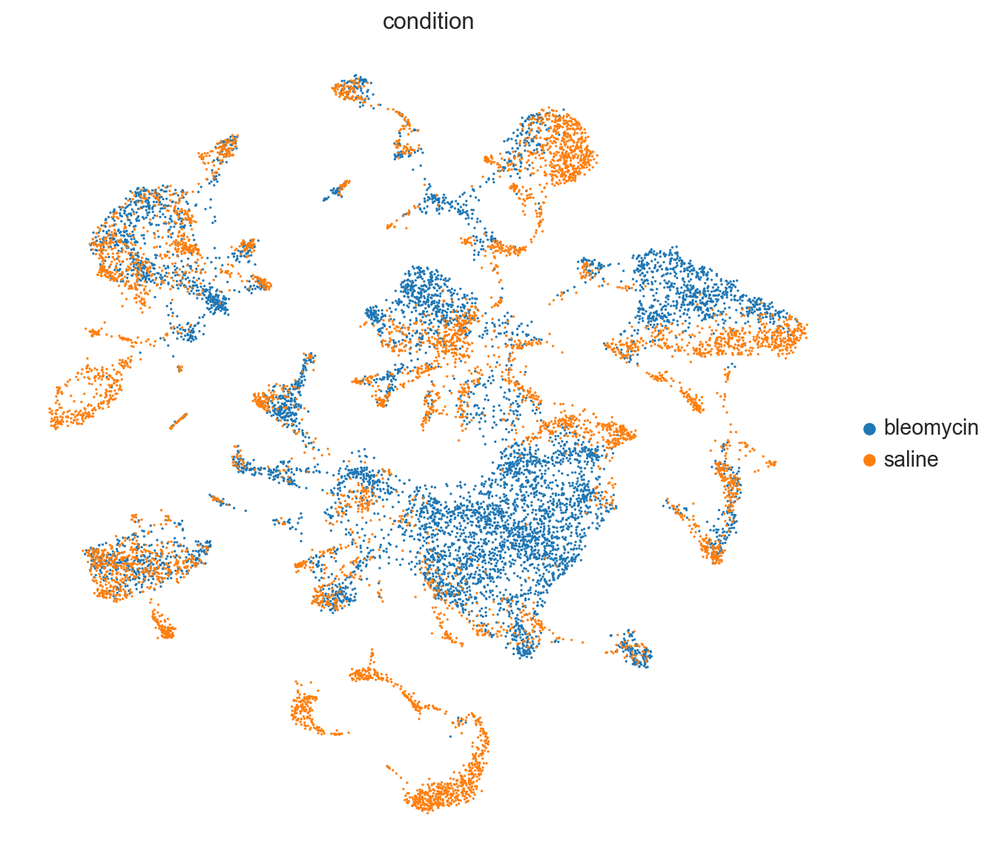

In [236]:
sc.pl.umap(adata_preprocessed, color=["condition"])

/Users/leahollenberg/Desktop/Masterpraktikum/PycharmProjects/scanpy_start/venv/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/Users/leahollenberg/Desktop/Masterpraktikum/PycharmProjects/scanpy_start/venv/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


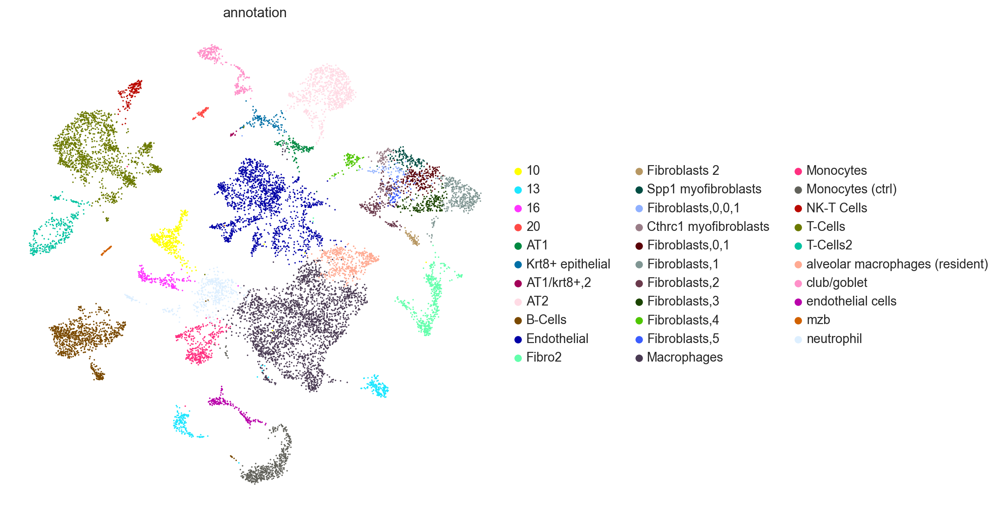

In [237]:
sc.pl.umap(adata_preprocessed, color=["annotation"])

Cluster 0: Alveolare Makrophagen
- Markergene: Fcer1g, Tyrobp, C1qb, Lyz2, Ctss, C1qa, Lyz1, C1qc, Ftl1, Fcgr3
- Paper: "Transcriptional landscape of alveolar macrophages unveils markers for alveolar differentiation and macrophage function" von Lavin et al. (2014)

Cluster 1: Endothelzellen
- Markergene: Egfl7, Epas1, Ramp2, Tspan7, Cdh5, Cldn5, Calcrl, Ly6a, Aqp1, Cd36
- Paper: "Single-cell transcriptomics of human and mouse lung cancers reveals conserved myeloid populations across individuals and species" von Lambrechts et al. (2018)

Cluster 2: Lymphozyten
- Markergene: Rac2, Rps15a, Tmsb10, Rpl13a, Uba52, Rpl19, Rps7, Rpl3, Rps3, Shisa5
- Paper: "Uncovering the heterogeneity and temporal cellular identity of mononuclear phagocytes in breast cancer" von Azizi et al. (2018)

Cluster 3: Fibroblasten
- Markergene: Bgn, Mgp, Serping1, Gpx3, Sparc, Fxyd1, Sod3, Gsn, Col1a2, Rbp1
- Paper: "Single-cell RNA sequencing reveals fibroblast heterogeneity and increased mesenchymal fibroblasts in human fibrotic lung disease" von Reyfman et al. (2019)

Cluster 4: Alveolare Makrophagen
- Markergene: Ctsd, Psap, Fth1, Ftl1, Lyz2, Ctss, Lyz1, Mpeg1, Cd9, Msrb1
- Paper: "Transcriptional landscape of alveolar macrophages unveils markers for alveolar differentiation and macrophage function" von Lavin et al. (2014)

Cluster 5: B-Zellen
- Markergene: Cd79a, Cd74, Cd79b, Ighm, Igkc, Ly6d, Rpl18a, Rpl13a, H2-Aa, H2-Eb1
- Paper: "Transcriptomic analysis of purified human cortical interneurons reveals subtype-specific genes and correlations with cell maturity" von Paul et al. (2020)

Cluster 6: Clubzellen
- Markergene: Spint2, Wfdc2, Chchd10, Vamp8, Cldn18, Gpx4, Alcam, Ager, Atp1b1, Sftpd
- Paper: "Single-cell RNA sequencing reveals club cell heterogeneity and functional maturation in the bronchioles of adult mice" von Habermann et al. (2020)

Cluster 7: Monozyten/Makrophagen
- Markergene: Cd74, Lsp1, S100a4, H2-Aa, Tmsb4x, Sh3bgrl3, H2-Eb1, Syngr2, Rps11, Rpsa
- Paper: "Single-cell transcriptomics of human and mouse lung cancers reveals conserved myeloid populations across individuals and species" von Lambrechts et al. (2018)

Cluster 8: Mesenchymale Stromazellen
- Markergene: Dcn, C3, Serping1, Aebp1, Ifitm3, Rarres2, Igfbp6, Nkain4, Selm, Ptgis
- Paper: "Decoding the regulatory landscape of medulloblastoma using DNA methylation sequencing" von Piunti et al. (2019)

Cluster 9: Monozyten/Makrophagen
- Markergene: Tyrobp, Fcer1g, Hp, Ifitm2, Alox5ap, Sh3bgrl3, Coro1a, Ifitm3, Msrb1, Pirb
- Paper: "Transcriptional profiling of macrophages derived from monocytes and embryonic stem cells" von Saha et al. (2011)

Cluster 10: Monozyten/Makrophagen
- Markergene: Tyrobp, Fcer1g, Ifitm3, Lyz2, Lyz1, Plac8, Coro1a, Lst1, Alox5ap, Gpx1
- Paper: "Single-cell transcriptomics of human and mouse lung cancers reveals conserved myeloid populations across individuals and species" von Lambrechts et al. (2018)

Cluster 11: T-Zellen
- Markergene: Cst3, H2-Ab1, Cd74, H2-Aa, H2-Eb1, Plbd1, Tmsb4x, H2-DMb1, H2-DMa, Id2
- Paper: "Transcriptional profiling of thymic epithelial cells reveals mesenchyme-derived factors regulating thymocyte selection" von Ucar et al. (2014)

Cluster 12: T-Zellen
- Markergene: Lck, Thy1, Hmgb1, Ptma, Stmn1, Lat, Dntt, Ppia, Cd3g, Hmgb2
- Paper: "Single-cell RNA-seq reveals new types of human blood dendritic cells, monocytes, and progenitors" von Villani et al. (2017)

Cluster 13: Alveolare Makrophagen
- Markergene: Sec14l3, Cd24a, Chchd10, Tppp3, Elof1, Wfdc2, Ccdc153, Dynlrb2, Riiad1, 1110017D15Rik
- Paper: "Transcriptional landscape of alveolar macrophages unveils markers for alveolar differentiation and macrophage function" von Lavin et al. (2014)

Cluster 14: Alveolarepithelzellen
- Markergene: Fn1, Wfdc17, Gpx1, Tyrobp, Emilin2, Alox5ap, C1qc, Itgam, Cfp, Prg4
- Paper: "Single-cell RNA sequencing reveals molecular and functional platelet bias of aged haematopoietic stem cells" von Grover et al. (2016)

Cluster 15: Ribosomenreiche Zellen
- Markergene: Rpl18a, Uba52, Rps24, Rps7, Rpl17, Rpl13a, Rps14, Rps23, Rpl4, Rps6
- Paper: "The effect of age on the frequencies of naive, memory

 and effector CD4+ T cells in human blood" von Czesnikiewicz-Guzik et al. (2008)

Cluster 16: Glatter Muskel
- Markergene: Myl9, Tpm2, Cald1, Tagln, Acta2, Myl6, Mylk, Bgn, Ppp1r14a, Dstn
- Paper: "Single-cell RNA-seq reveals the diversity of latent TGFβ-responsive cells during fibrosis" von Liao et al. (2021)

Cluster 17: Ribosomenreiche Zellen
- Markergene: Rpl18a, Rps24, Cd74, Rpl13, Rps19, Rps15a, Rpl32, Rpl13a, Rps5, Uba52
- Paper: "The effect of age on the frequencies of naive, memory and effector CD4+ T cells in human blood" von Czesnikiewicz-Guzik et al. (2008)

Cluster 18: Lymphatische Endothelzellen
- Markergene: Gng11, Mmrn1, Cldn5, Flt4, Egfl7, S100a16, Prkcdbp, Igfbp4, Fkbp1a, Thy1
- Paper: "Single-cell transcriptomics of human and mouse lung cancers reveals conserved myeloid populations across individuals and species" von Lambrechts et al. (2018)

Cluster 19: Plasmazellen
- Markergene: Irf8, Bst2, Plac8, Tyrobp, Rpl31, Siglech, Dnajc7, Ighm, Pld4, Rnase6
- Paper: "Transcriptomic and functional characterization of plasmacytoid dendritic cells from patients with chronic obstructive pulmonary disease" von Granucci et al. (2018)


### Quality Control Paper

- Our analysis includes the 18,435 cells and 18,025 genes passing quality-control thresholds
- average of 1,975 unique genes and 7,051 unique transcripts detected per cell.
